<a href="https://colab.research.google.com/github/Nnalue-Emeka/Python_Projects/blob/main/Exploratory_Analysis_of_Billionaires_Dataset.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
#Libraries for data cleaning, preprocessing and analysis
import numpy as np # linear algebra
import pandas as pd # data processing
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import LabelEncoder, LabelBinarizer, OneHotEncoder
from pandas import get_dummies

# Libraries for data visulisation
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()

In [ ]:
from google.colab import files
uploaded= files.upload() # setting up the workbook for data importation

Saving billionaires.csv to billionaires.csv


In [ ]:
# importing dataset
df = pd.read_csv("billionaires.csv")

df.head() # View the first five role of the dataset

,name,rank,year,company.founded,company.name,company.relationship,company.sector,company.type,demographics.age,demographics.gender,...,location.gdp,location.region,wealth.type,wealth.worth in billions,wealth.how.category,wealth.how.from emerging,wealth.how.industry,wealth.how.inherited,wealth.how.was founder,wealth.how.was political
0,Bill Gates,1,1996,1975,Microsoft,founder,Software,new,40,male,...,8.100000e+12,North America,founder non-finance,18.5,New Sectors,True,Technology-Computer,not inherited,True,True
1,Bill Gates,1,2001,1975,Microsoft,founder,Software,new,45,male,...,1.060000e+13,North America,founder non-finance,58.7,New Sectors,True,Technology-Computer,not inherited,True,True
2,Bill Gates,1,2014,1975,Microsoft,founder,Software,new,58,male,...,0.000000e+00,North America,founder non-finance,76.0,New Sectors,True,Technology-Computer,not inherited,True,True
3,Warren Buffett,2,1996,1962,Berkshire Hathaway,founder,Finance,new,65,male,...,8.100000e+12,North America,founder non-finance,15.0,Traded Sectors,True,Consumer,not inherited,True,True
4,Warren Buffett,2,2001,1962,Berkshire Hathaway,founder,Finance,new,70,male,...,1.060000e+13,North America,founder non-finance,32.3,Traded Sectors,True,Consumer,not inherited,True,True


In [ ]:
import io
buffer = io.StringIO()
df.info(buf=buffer)
s = buffer.getvalue()
with open("df_info.txt", "w", encoding="utf-8") as f:
    f.write(s)

# Summary and descriptive statistics of the dataset

In [ ]:
df1 = df.copy() # Duplicating the dataset to aviod loss the original dataset

In [ ]:
pd.options.display.max_columns = None # Allowing the dataframe to displace all the columns
pd.options.display.max_rows = None   # Allowing the dataframe to displace all the columns

In [ ]:
display(df1) # displaying all the columns and Rows

,name,rank,year,company.founded,company.name,company.relationship,company.sector,company.type,demographics.age,demographics.gender,location.citizenship,location.country code,location.gdp,location.region,wealth.type,wealth.worth in billions,wealth.how.category,wealth.how.from emerging,wealth.how.industry,wealth.how.inherited,wealth.how.was founder,wealth.how.was political
0,Bill Gates,1,1996,1975,Microsoft,founder,Software,new,40,male,United States,USA,8.100000e+12,North America,founder non-finance,18.5,New Sectors,True,Technology-Computer,not inherited,True,True
1,Bill Gates,1,2001,1975,Microsoft,founder,Software,new,45,male,United States,USA,1.060000e+13,North America,founder non-finance,58.7,New Sectors,True,Technology-Computer,not inherited,True,True
2,Bill Gates,1,2014,1975,Microsoft,founder,Software,new,58,male,United States,USA,0.000000e+00,North America,founder non-finance,76.0,New Sectors,True,Technology-Computer,not inherited,True,True
3,Warren Buffett,2,1996,1962,Berkshire Hathaway,founder,Finance,new,65,male,United States,USA,8.100000e+12,North America,founder non-finance,15.0,Traded Sectors,True,Consumer,not inherited,True,True
4,Warren Buffett,2,2001,1962,Berkshire Hathaway,founder,Finance,new,70,male,United States,USA,1.060000e+13,North America,founder non-finance,32.3,Traded Sectors,True,Consumer,not inherited,True,True
5,Carlos Slim Helu,2,2014,1990,Telmex,founder,Communications,privatization,74,male,Mexico,MEX,0.000000e+00,Latin America,privatized and resources,72.0,Non-Traded Sectors,True,Media,not inherited,True,True
6,Oeri Hoffman and Sacher,3,1996,1896,F. Hoffmann-La Roche,NaN,pharmaceuticals,new,0,NaN,Switzerland,CHE,3.300000e+11,Europe,inherited,13.1,New Sectors,True,Technology-Medical,3rd generation,True,True
7,Paul Allen,3,2001,1975,Microsoft,founder,technology,new,48,male,United States,USA,1.060000e+13,North America,founder non-finance,30.4,New Sectors,True,Technology-Computer,not inherited,True,True
8,Amancio Ortega,3,2014,1975,Zara,founder,Fashion,new,77,male,Spain,ESP,0.000000e+00,Europe,founder non-finance,64.0,Non-Traded Sectors,True,"Retail, Restaurant",not inherited,True,True
9,Lee Shau Kee,4,1996,1976,Henderson Land Development,founder/chairman,real estate,new,68,male,Hong Kong,HKG,1.600000e+11,East Asia,self-made finance,12.7,Financial,True,Real Estate,not inherited,True,True


In [ ]:
df1.shape[0]
print("The number of rows in this dataset: ", df1.shape[0])
print("The number of columns in this dataset: ", df1.shape[1])

The number of rows in this dataset:  2614
The number of columns in this dataset:  22


In [ ]:
df1.keys() # Columns in the dataset

Index(['name', 'rank', 'year', 'company.founded', 'company.name',
       'company.relationship', 'company.sector', 'company.type',
       'demographics.age', 'demographics.gender', 'location.citizenship',
       'location.country code', 'location.gdp', 'location.region',
       'wealth.type', 'wealth.worth in billions', 'wealth.how.category',
       'wealth.how.from emerging', 'wealth.how.industry',
       'wealth.how.inherited', 'wealth.how.was founder',
       'wealth.how.was political'],
      dtype='object')

In [ ]:
df1.describe().T # Descriptive Statistics of of the numerical columns

,count,mean,std,min,25%,50%,75%,max
rank,2614.0,5.996725e+02,4.678857e+02,1.0,215.0,430.0,9.880000e+02,1.565000e+03
year,2614.0,2.008412e+03,7.483598e+00,1996.0,2001.0,2014.0,2.014000e+03,2.014000e+03
company.founded,2614.0,1.924712e+03,2.437765e+02,0.0,1936.0,1963.0,1.985000e+03,2.012000e+03
demographics.age,2614.0,5.334124e+01,2.533332e+01,-42.0,47.0,59.0,7.000000e+01,9.800000e+01
location.gdp,2614.0,1.769103e+12,3.547083e+12,0.0,0.0,0.0,7.250000e+11,1.060000e+13
wealth.worth in billions,2614.0,3.531943e+00,5.088813e+00,1.0,1.4,2.0,3.500000e+00,7.600000e+01


In [ ]:
df1.info() # General information about the dataset

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2614 entries, 0 to 2613
Data columns (total 22 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   name                      2614 non-null   object 
 1   rank                      2614 non-null   int64  
 2   year                      2614 non-null   int64  
 3   company.founded           2614 non-null   int64  
 4   company.name              2576 non-null   object 
 5   company.relationship      2568 non-null   object 
 6   company.sector            2591 non-null   object 
 7   company.type              2578 non-null   object 
 8   demographics.age          2614 non-null   int64  
 9   demographics.gender       2580 non-null   object 
 10  location.citizenship      2614 non-null   object 
 11  location.country code     2614 non-null   object 
 12  location.gdp              2614 non-null   float64
 13  location.region           2614 non-null   object 
 14  wealth.t

# Data Preprocessing

In [ ]:
df1.isnull().sum() # Checking for null values

name                         0
rank                         0
year                         0
company.founded              0
company.name                38
company.relationship        46
company.sector              23
company.type                36
demographics.age             0
demographics.gender         34
location.citizenship         0
location.country code        0
location.gdp                 0
location.region              0
wealth.type                 22
wealth.worth in billions     0
wealth.how.category          1
wealth.how.from emerging     0
wealth.how.industry          1
wealth.how.inherited         0
wealth.how.was founder       0
wealth.how.was political     0
dtype: int64

In [ ]:
duplicate_rows_df = df1[df1.duplicated()]  # Checking for duplicates
duplicate_rows_df

,name,rank,year,company.founded,company.name,company.relationship,company.sector,company.type,demographics.age,demographics.gender,location.citizenship,location.country code,location.gdp,location.region,wealth.type,wealth.worth in billions,wealth.how.category,wealth.how.from emerging,wealth.how.industry,wealth.how.inherited,wealth.how.was founder,wealth.how.was political


In [ ]:
df1.nunique() # Number of Unique values in each of the columns

name                        2077
rank                         468
year                           3
company.founded              178
company.name                1577
company.relationship          74
company.sector               520
company.type                  18
demographics.age              76
demographics.gender            3
location.citizenship          73
location.country code         74
location.gdp                  81
location.region                8
wealth.type                    5
wealth.worth in billions     183
wealth.how.category            9
wealth.how.from emerging       1
wealth.how.industry           19
wealth.how.inherited           6
wealth.how.was founder         1
wealth.how.was political       1
dtype: int64

In [ ]:
for col in df1:
    print(col)
    print(df1[col].unique())
    print('\n')  # Unique values in the columns

name
['Bill Gates' 'Warren Buffett' 'Carlos Slim Helu' ... 'Yang Keng'
 'Zdenek Bakala' 'Zhu Wenchen']


rank
[   1    2    3    4    5    6    7    8    9   10   11   12   13   14
   15   16   17   18   19   20   21   22   23   24   25   26   27   28
   29   30   31   32   33   34   35   36   37   38   39   40   41   42
   43   44   45   46   47   48   49   50   51   52   53   54   55   56
   57   58   59   60   61   62   63   64   65   66   67   68   69   70
   71   72   73   74   75   76   77   78   79   80   81   82   83   84
   85   86   87   88   89   90   91   92   93   94   95   96   97   98
   99  100  101  102  103  104  105  106  107  108  109  110  111  112
  113  114  115  116  117  118  119  120  121  122  123  124  125  126
  127  128  129  130  131  132  133  134  135  136  137  138  139  140
  141  142  143  144  145  146  147  148  149  150  151  152  153  154
  155  156  157  158  159  160  161  162  163  164  165  166  167  168
  169  170  171  172  173  174  175  1

In [ ]:
np.where(df1['wealth.how.industry'].isnull()==True)[0]

array([2518])

In [ ]:
df1.iloc[2518,:]

name                               Kim Taek-Jin
rank                                       1540
year                                       2014
company.founded                            1997
company.name                             NCSOFT
company.relationship                    founder
company.sector                    online gaming
company.type                                new
demographics.age                              0
demographics.gender                        male
location.citizenship                South Korea
location.country code                       KOR
location.gdp                                0.0
location.region                       East Asia
wealth.type                 founder non-finance
wealth.worth in billions                    1.1
wealth.how.category                 New Sectors
wealth.how.from emerging                   True
wealth.how.industry                         NaN
wealth.how.inherited              not inherited
wealth.how.was founder                  

In [ ]:
df1['wealth.how.industry'].unique()

array(['Technology-Computer', 'Consumer', 'Media', 'Technology-Medical',
       'Retail, Restaurant', 'Real Estate', 'Hedge funds',
       'Money Management', 'Diversified financial', 'Constrution',
       'Non-consumer industrial', 'Energy', 'Mining and metals',
       'Private equity/leveraged buyout', 'Other', '0', 'banking',
       'services', 'Venture Capital', nan], dtype=object)

In [ ]:
df1.index[df1['wealth.how.industry'] == '0'].tolist()

[384,
 548,
 632,
 714,
 798,
 872,
 955,
 985,
 1085,
 1148,
 1914,
 2354,
 2400,
 2422,
 2448,
 2555]

In [ ]:
df1[df1['wealth.how.industry'].eq("0")]

,name,rank,year,company.founded,company.name,company.relationship,company.sector,company.type,demographics.age,demographics.gender,location.citizenship,location.country code,location.gdp,location.region,wealth.type,wealth.worth in billions,wealth.how.category,wealth.how.from emerging,wealth.how.industry,wealth.how.inherited,wealth.how.was founder,wealth.how.was political
384,Porsche family,128,1996,1931,Porsche,NaN,cars,new,0,NaN,Germany,DEU,2.500000e+12,Europe,inherited,2.5,0,True,0,father,True,True
548,Eugenio Garza Lagnera,182,2001,1890,Femsa,relation,beverages,new,0,male,Mexico,MEX,7.250000e+11,Latin America,inherited,2.5,0,True,0,3rd generation,True,True
632,H Wayne Huizenga,209,2001,1968,Waste Management,founder,waste management,new,63,male,United States,USA,1.060000e+13,North America,self-made finance,2.2,Financial,True,0,not inherited,True,True
714,Robert Naify,234,2001,1912,NaN,relation,movie theatres,new,79,male,United States,USA,1.060000e+13,North America,inherited,2.0,0,True,0,father,True,True
798,Yeoh Tiong Lay,264,1996,1955,YTL Corporation,founder,"construction, utilities",new,0,male,Malaysia,MYS,1.010000e+11,East Asia,founder non-finance,1.5,0,True,0,not inherited,True,True
872,H Wayne Huizenga,291,1996,1968,Waste Management,founder,waste management,new,58,male,United States,USA,8.100000e+12,North America,self-made finance,1.4,Financial,True,0,not inherited,True,True
955,Robert Johnson,312,2001,1980,Black Entertainment Television,founder,media,new,54,male,United States,USA,1.060000e+13,North America,founder non-finance,1.6,0,True,0,not inherited,True,True
985,Reimann family,327,1996,1923,Benckiser,NaN,consumer goods,aquired,0,NaN,Germany,DEU,2.500000e+12,Europe,inherited,1.2,0,True,0,not inherited,True,True
1085,Eugenio Garza Lagnera,361,1996,1890,Femsa,relation,beverages,new,0,male,Mexico,MEX,3.970000e+11,Latin America,inherited,1.1,0,True,0,3rd generation,True,True
1148,Carl Lindner Jr,379,1996,1959,American Financial Group,founder,banking,new,76,male,United States,USA,8.100000e+12,North America,founder non-finance,1.1,0,True,0,not inherited,True,True


In [ ]:
#Replacing null values and zeros (0) for column industry
df1.iloc[[548,632,714,872,1085,2400,2422,2448,2518],[18]]="Other"
df1.iloc[[384,985],[18]]="Consumer"
df1.iloc[[955],[18]]="Media"
df1.iloc[[1148],[18]]="banking"
df1.iloc[[2354],[18]]="Real Estate"
df1.iloc[[2555],[18]]="Mining and metals"
df1.iloc[[1914],[18]]="Retail"
df1.iloc[[798],[18]]="Constrution"
df1['wealth.how.industry'] = df1['wealth.how.industry'].replace(['Constrution', 'banking', 'Banking','Retail, Restaurant'],
                                                                ['Construction', 'Diversified financial', 'Diversified financial','Retail'])

In [ ]:
df1[df1['location.region'].eq("0")]

,name,rank,year,company.founded,company.name,company.relationship,company.sector,company.type,demographics.age,demographics.gender,location.citizenship,location.country code,location.gdp,location.region,wealth.type,wealth.worth in billions,wealth.how.category,wealth.how.from emerging,wealth.how.industry,wealth.how.inherited,wealth.how.was founder,wealth.how.was political
671,Ernest Stempel,222,2001,1919,AIG,chairman,insurance,new,84,male,Bermuda,BMU,3.680000e+09,0,executive,2.1,New Sectors,True,Technology-Medical,not inherited,True,True


In [ ]:
df1['location.region'] = df1['location.region'].replace(['0'], 'North America') # Replacing zeros

In [ ]:
df1[df1['company.type'].isnull()]

,name,rank,year,company.founded,company.name,company.relationship,company.sector,company.type,demographics.age,demographics.gender,location.citizenship,location.country code,location.gdp,location.region,wealth.type,wealth.worth in billions,wealth.how.category,wealth.how.from emerging,wealth.how.industry,wealth.how.inherited,wealth.how.was founder,wealth.how.was political
204,Shin Kyuk-Ho,69,1996,0,NaN,NaN,NaN,NaN,0,NaN,South Korea,KOR,6.030000e+11,East Asia,NaN,3.6,Traded Sectors,True,Consumer,not inherited,True,True
265,Rinat Akhmetov,88,2014,2000,System Capital Management Group,founder,industrial manufacturing and banking,NaN,47,male,Ukraine,UKR,0.000000e+00,Europe,privatized and resources,12.5,Resource Related,True,Non-consumer industrial,not inherited,True,True
392,Eitaro Itoyama,130,2001,0,NaN,NaN,golf courses,NaN,58,male,Japan,JPN,4.160000e+12,East Asia,self-made finance,3.3,Financial,True,Real Estate,not inherited,True,True
399,Goroemon Yoshimoto,132,1996,0,NaN,NaN,NaN,NaN,0,male,Japan,JPN,4.710000e+12,East Asia,NaN,2.5,Financial,True,Real Estate,not inherited,True,True
404,Rinji Shino,133,1996,1949,Meiko Group,NaN,real estate,NaN,0,male,Japan,JPN,4.710000e+12,East Asia,NaN,2.5,Financial,True,Real Estate,not inherited,True,True
472,Eitaro Itoyama,155,1996,0,NaN,NaN,golf courses,NaN,53,male,Japan,JPN,4.710000e+12,East Asia,self-made finance,2.3,Financial,True,Real Estate,not inherited,True,True
522,Funke family,174,1996,0,NaN,NaN,NaN,NaN,0,NaN,Germany,DEU,2.500000e+12,Europe,NaN,2.1,Non-Traded Sectors,True,Media,not inherited,True,True
529,Masahiro Ohga,176,1996,0,NaN,NaN,NaN,NaN,0,male,Japan,JPN,4.710000e+12,East Asia,NaN,2.1,Non-Traded Sectors,True,Media,not inherited,True,True
695,Goulandris family,231,1996,0,Fitzwilton,NaN,shipping,NaN,0,NaN,Greece,GRC,1.470000e+11,Europe,inherited,1.7,Financial,True,Money Management,not inherited,True,True
758,John Jahr,251,2001,0,NaN,NaN,media,NaN,0,male,Germany,DEU,1.950000e+12,Europe,inherited,1.9,Non-Traded Sectors,True,Media,not inherited,True,True


In [ ]:
np.where(df1['company.type'].isnull()==True)[0] # identifying the rows with null values

array([ 204,  265,  392,  399,  404,  472,  522,  529,  695,  758,  787,
        789,  907,  908,  934,  984,  986, 1016, 1080, 1082, 1083, 1098,
       1200, 1205, 1207, 1220, 1223, 1231, 1281, 1301, 1313, 1354, 1405,
       1666, 2074, 2506])

In [ ]:
df1['company.type'] = df1['company.type'].replace(
    ['new division', ' new', 'new ','neew' ,'privatization',
     'new/aquired', 'aquired',' acquired',  'new, privitization', 'privitized'],
      ['new', 'new', 'new','new' ,'privatized', 'acquired', 'acquired','acquired',  'privatized', 'privatized']) # Cleaning up format errors

In [ ]:
df1["company.type"] = df1["company.type"].fillna(0) # Replacing null values with zeros

In [ ]:
df1['company.type'] = np.where((df1['company.type'] == 0) & (df1['wealth.how.inherited'] == 'not inherited') &
                               (df1['company.relationship'] == 'founder'), 'new', df1['company.type'])


df1['company.type'] = np.where((df1['company.type'] == 0), 'Other', df1['company.type']) # Replacing zeros with new where company relationship column and waelth.how.inherited equals founder and not inherited respectively

In [ ]:
df1[df1['location.gdp'].eq(0)] # Identifying rows with zeros

,name,rank,year,company.founded,company.name,company.relationship,company.sector,company.type,demographics.age,demographics.gender,location.citizenship,location.country code,location.gdp,location.region,wealth.type,wealth.worth in billions,wealth.how.category,wealth.how.from emerging,wealth.how.industry,wealth.how.inherited,wealth.how.was founder,wealth.how.was political
2,Bill Gates,1,2014,1975,Microsoft,founder,Software,new,58,male,United States,USA,0.0,North America,founder non-finance,76.0,New Sectors,True,Technology-Computer,not inherited,True,True
5,Carlos Slim Helu,2,2014,1990,Telmex,founder,Communications,privatized,74,male,Mexico,MEX,0.0,Latin America,privatized and resources,72.0,Non-Traded Sectors,True,Media,not inherited,True,True
8,Amancio Ortega,3,2014,1975,Zara,founder,Fashion,new,77,male,Spain,ESP,0.0,Europe,founder non-finance,64.0,Non-Traded Sectors,True,Retail,not inherited,True,True
11,Warren Buffett,4,2014,1839,Berkshire Hathaway,founder,Finance,acquired,83,male,United States,USA,0.0,North America,founder non-finance,58.2,Traded Sectors,True,Consumer,not inherited,True,True
12,Tsai Wan-lin,5,1996,1962,Lin Yuan Group,founder,banking and insurance,new,71,male,Taiwan,Taiwan,0.0,East Asia,self-made finance,12.2,Financial,True,Hedge funds,not inherited,True,True
14,Larry Ellison,5,2014,1977,Oracle,founder,software,new,69,male,United States,USA,0.0,North America,founder non-finance,48.0,New Sectors,True,Technology-Computer,not inherited,True,True
17,Charles Koch,6,2014,1940,Koch industries,relation,Oil refining,new,78,male,United States,USA,0.0,North America,inherited,40.0,Financial,True,Diversified financial,father,True,True
18,David Koch,6,2014,1940,Koch industries,relation,Oil refining,new,73,male,United States,USA,0.0,North America,inherited,40.0,Financial,True,Diversified financial,father,True,True
23,Sheldon Adelson,8,2014,1952,Las Vegas Sands,founder,casinos,acquired,80,male,United States,USA,0.0,North America,self-made finance,38.0,Financial,True,Real Estate,not inherited,True,True
26,Christy Walton,9,2014,1962,Walmart,relation,retail,new,59,female,United States,USA,0.0,North America,inherited,36.7,Non-Traded Sectors,True,Retail,spouse/widow,True,True


In [ ]:
df1['location.gdp'] = df1['location.gdp'].replace([0.0], np.nan) # Replacing zeros with null


In [ ]:
df1[df1['location.gdp'].eq(0)]

,name,rank,year,company.founded,company.name,company.relationship,company.sector,company.type,demographics.age,demographics.gender,location.citizenship,location.country code,location.gdp,location.region,wealth.type,wealth.worth in billions,wealth.how.category,wealth.how.from emerging,wealth.how.industry,wealth.how.inherited,wealth.how.was founder,wealth.how.was political


In [ ]:
Ranking_Years = [1996, 2001, 2014]
Country = ['United States', 'Mexico', 'Switzerland' ,'Spain', 'Hong Kong' ,'Taiwan',
 'Germany', 'Saudi Arabia', 'Japan' ,'Sweden', 'France', 'Canada', 'Philippines',
 'Indonesia', 'South Korea', 'Malaysia', 'Italy', 'Singapore', 'Nigeria',
 'Brazil', 'Russia', 'India', 'United Kingdom', 'Australia' ,'Thailand',
 'Kuwait', 'Turkey', 'Chile', 'Netherlands', 'Venezuela', 'China', 'Argentina',
 'Greece' ,'Colombia', 'Cyprus', 'South Africa', 'Ireland', 'Ukraine',
 'Czech Republic', 'Israel', 'Denmark', 'Lebanon', 'Austria', 'New Zealand',
 'Egypt' ,'Bermuda', 'Portugal', 'United Arab Emirates', 'Liechtenstein',
 'Georgia', 'Norway' ,'Belgium', 'Ecuador', 'Bahrain', 'Peru' ,'Angola',
 'Swaziland', 'Poland', 'Finland', 'Algeria', 'Morocco', 'Guernsey',
 'Kazakhstan', 'Macau' ,'Monaco', 'Vietnam', 'Romania', 'St. Kitts and Nevis',
 'Oman', 'Nepal' ,'Uganda' ,'Lithuania' ,'Tanzania']
for i in Country:
  for k in Ranking_Years:
    df1['location.gdp'] = df1['location.gdp'].fillna(df1[(df1['year']== k) & df1['location.citizenship']== i]['location.gdp'].mean()) # imputation of the mean values to fill null values

In [ ]:
d = {'Aruba': 2791061452.51397, 'Africa Eastern and Southern': 1003403000510.52, 'Afghanistan': 20550582746.8448,
'Africa Western and Central': 892497905712.366, 'Angola': 137244439121.374, 'Albania': 13228147516.1168,
'Andorra': 3271808157.30038, 'Arab World': 2895457837893.28, 'United Arab Emirates': 414105366758.911,
'Argentina': 526319673731.638, 'Armenia': 11609512939.7542, 'American Samoa': 643000000,
'Antigua and Barbuda': 1249733333.33333, 'Australia': 1467545212521.8, 'Austria': 442584815286.034,
'Azerbaijan': 75244294275.1498, 'Burundi': 2705783272.07443, 'Belgium': 535390200131.018,
'Benin': 13284527850.2632, 'Burkina Faso': 13943016923.9017, 'Bangladesh': 172885454931.453,
'Bulgaria': 57082011260.3446, 'Bahrain': 33387712765.9574, 'Bahamas, The': 11176100000,
'Bosnia and Herzegovina': 18558343304.8433, 'Belarus': 78813839984.3506, 'Belize': 2138000000,
'Bermuda': 6413988000, 'Bolivia': 32996188017.3661, 'Brazil': 2455993625159.37, 'Barbados': 4696344350,
'Brunei Darussalam': 17098342541.4365, 'Bhutan': 1907090813.45906, 'Botswana': 15470059201.6577,
'Central African Republic': 1894813504.52945, 'Canada': 1805749878439.94, 'Central Europe and the Baltics': 1462687483688.63,
'Switzerland': 726537808338, 'Chile': 259405202008.001, 'China': 10475682920594.5, "Cote d'Ivoire": 48843008580.3288,
'Cameroon': 36386546917.6861, 'Congo, Dem. Rep.': 35909040265.9328, 'Congo, Rep.': 17912908765.9058, 'Colombia': 381112110485.385,
'Comoros': 1149587651.69395, 'Cabo Verde': 1859898513.26858, 'Costa Rica': 52016408950.8936, 'Caribbean small states': 76921757095.9507,
 'Cuba': 80656000000, 'Curacao': 3048435754.18994, 'Cayman Islands': 4563017880.71523, 'Cyprus': 23226782250.5646,
 'Czech Republic': 209358834156.329, 'Germany': 3889093051023.52, 'Djibouti': 2214679081.25658, 'Dominica': 520207407.407407,
  'Denmark': 352993631617.708, 'Dominican Republic': 67179914026.9623, 'Algeria': 213810024944.464,
  'East Asia & Pacific (excluding high income)': 12798834538401.6, 'Early-demographic dividend': 10651444170099.7,
 'East Asia & Pacific': 22086206227634.1, 'Europe & Central Asia (excluding high income)': 3845830327604.58,
 'Europe & Central Asia': 23779706739057.1, 'Ecuador': 101726331000, 'Egypt': 305595408895.265,
 'Euro area': 13510071267777.2, 'Spain': 1371820537888.62, 'Estonia': 26634083965.0987,
 'Ethiopia': 55612228233.5179, 'European Union': 15649727528817.4, 'Fragile and conflict affected situations': 2076425470130.52,
 'Finland': 274862826772.156, 'Fiji': 4857220601.80003, 'France': 2855964488590.19, 'Faroe Islands': 2913995545.65702,
 'Micronesia, Fed. Sts.': 319271200, 'Gabon': 18203968001.8908, 'United Kingdom': 3065223279583.79, 'Georgia': 17627003454.7205,
 'Ghana': 54782847752.5375, 'Guinea': 8778473614.54728, 'Gambia': 1229460601.92174,
 'Guinea-Bissau': 1054915645.19654, 'Equatorial Guinea': 21765454404.421, 'Greece': 235458133124.608,
 'Grenada': 911500000, 'Greenland': 2842048997.77283, 'Guatemala': 57852399963.7878, 'Guam': 5610000000,
 'Guyana': 4127659492.02031, 'High income': 51110586217074.2, 'Hong Kong': 291459356985.337,
 'Honduras': 19756494434.7031, 'Heavily indebted poor countries (HIPC)': 714858431631.064,
 'Croatia': 58423981441.1801, 'Haiti': 15139264670.4225, 'Hungary': 141033843265.669,
 'IBRD only': 27596941006701.8, 'IDA & IBRD total': 29706781908185.5, 'IDA total': 2109886623705.46,
 'IDA blend': 1076797852842.96, 'Indonesia': 890814755233.225, 'IDA only': 1033070152181.74, 'Isle of Man': 7708834951.45631,
 'India': 2039127446299.3,'Ireland': 259170903647.536, 'Iran, Islamic Rep.': 460382791826.34,
 'Iraq': 228415656174.957, 'Iceland': 17867662177.8911, 'Israel': 314330061977.263, 'Italy': 2162009615996.54,
 'Jamaica': 13899228824.2161, 'Jordan': 36847643587.2383, 'Japan': 4896994405353.29, 'Kazakhstan': 221415572819.5,
 'Kenya': 68285768554.472, 'Kyrgyz Republic': 7468096566.71158, 'Cambodia': 16702610842.4025, 'Kiribati': 177862267.892555,
 'St. Kitts and Nevis': 953174074.074074, 'South Korea': 1484318219633.63, 'Kuwait': 162631412508.784,
 'Latin America & Caribbean (excluding high income)': 5411098182314.47, 'Lao PDR': 13279248478.8161,
 'Lebanon': 48095213746.4677, 'Liberia': 3225652000, 'Libya': 57372445771.7699, 'St. Lucia': 1749289302.71075,
 'Latin America & Caribbean': 6428176699785.61, 'Least developed countries: UN classification': 980969667648.589,
 'Low income': 469062546850.348, 'Liechtenstein': 6657170923.37918, 'Sri Lanka': 82528526229.5245,
 'Lower middle income': 6722603075159.65, 'Low & middle income': 28139724658674.5, 'Lesotho': 2441053175.70743,
 'Late-demographic dividend': 19771028710486, 'Lithuania': 48533659592.1728, 'Luxembourg': 68804811897.6445, 'Latvia': 31386896487.0407,
 'Macau': 54903031137.7096, 'St. Martin (French part)': 772950710.774545, 'Morocco': 119131365761.393, 'Monaco': 7069616048.89066,
 'Moldova': 9510198961.57287, 'Madagascar': 12522957228.1764, 'Maldives': 3697351596.83753, 'Middle East & North Africa': 3592211517559.91,
 'Mexico': 1315351183524.54, 'Marshall Islands': 185172900, 'Middle income': 27662207338671.7, 'North Macedonia': 11362272837.8818,
 'Mali': 14364937996.8661, 'Malta': 11626278729.9057, 'Myanmar': 63264892768.3726,
 'Middle East & North Africa (excluding high income)': 1600856649200.36, 'Montenegro': 4594024179.62003, 'Mongolia': 12226514722.0861,
 'Northern Mariana Islands': 832000000, 'Mozambique': 17716084107.5888, 'Mauritania': 6592537781.81518, 'Mauritius': 13074137210.3352,
 'Malawi': 6047813437.31804, 'Malaysia': 338061963396.376, 'North America': 19362844040439.9, 'Namibia': 12435416063.4689,
 'New Caledonia': 10635039738.6899, 'Niger': 10862944203.5591, 'Nigeria': 574183825592.358, 'Nicaragua': 11880434070.7811,
 'Netherlands': 892167986713.722, 'Norway': 498410050251.256, 'Nepal': 22731602969.9687, 'Nauru': 104654365.188653,
 'New Zealand': 201313497220.917, 'OECD members': 50275463968704.1, 'Oman': 92699089726.9181,
 'Other small states': 446440919346.858, 'Pakistan': 244360888750.807, 'Panama': 49921400000, 'Peru': 200789362451.567,
 'Philippines': 297483247101.038, 'Palau': 241669800, 'Papua New Guinea': 23210682538.3928, 'Poland': 539087652559.835,
 'Pre-demographic dividend': 1557383366315.75, 'Puerto Rico': 102445800000, 'Portugal': 229901964221.884, 'Paraguay': 40377929295.6419,
 'West Bank and Gaza': 13989700000, 'Pacific island small states': 9269083212.90386, 'Post-demographic dividend': 47144535617382.8,
 'French Polynesia': 6151998957.96572, 'Qatar': 206224598571.429, 'Romania': 199712289501.971, 'Russia': 2059241965490.83,
 'Rwanda': 8234762201.03869, 'South Asia': 2587788944338.2, 'Saudi Arabia': 756350347320.381, 'Sudan': 76818327441.6497,
 'Senegal': 19797254643.1212, 'Singapore': 314851156183.411, 'Solomon Islands': 1335579569.64462, 'Sierra Leone': 5015157815.73406,
 'El Salvador': 22593470000, 'San Marino': 1673973694.69908, 'Somalia': 5024999991.72061, 'Serbia': 47062206677.6539,
 'Sub-Saharan Africa (excluding high income)': 1894537271575.48, 'South Sudan': 13962212847.4576, 'Sub-Saharan Africa': 1895924778369.51,
 'Small states': 532631759655.713, 'Sao Tome and Principe': 346528329.183227, 'Suriname': 5240606060.60606, 'Slovak Republic': 101437045019.901,
 'Slovenia': 49997186439.0916, 'Sweden': 581964017237.095, 'Eswatini': 4422968339.67584, 'Sint Maarten (Dutch part)': 1245251396.64804,
 'Seychelles': 1387581391.70001, 'Syrian Arab Republic': 21502061462.2122, 'Turks and Caicos Islands': 841070000, 'Chad': 13940768065.6063,
 'East Asia & Pacific (IDA & IBRD countries)': 12782234168171.3, 'Europe & Central Asia (IDA & IBRD countries)': 4643054251107.57,
 'Togo': 4574986536.90791, 'Thailand': 407339454060.678, 'Tajikistan': 9112544556.05962, 'Turkmenistan': 43524210526.3158,
 'Latin America & the Caribbean (IDA & IBRD countries)': 6211056036390.84, 'Timor-Leste': 1447310448.58225,
 'Middle East & North Africa (IDA & IBRD countries)': 1586866949200.36, 'Tonga': 439878828.008608,
 'South Asia (IDA & IBRD)': 2587788944338.2, 'Sub-Saharan Africa (IDA & IBRD countries)': 1895924778369.51,
 'Trinidad and Tobago': 29489012807.1382, 'Tunisia': 50271072627.6727, 'Turkey': 938952628604.067,
 'Tuvalu': 38759689.9224806, 'Tanzania': 49964825081.1078, 'Uganda': 32612397758.4579, 'Ukraine': 133503411375.739,
 'Upper middle income': 20939604263512.1, 'Uruguay': 57236013086.1223, 'United States': 17550680174000,
 'Uzbekistan': 80845384375.1236, 'St. Vincent and the Grenadines': 770901444.444444, 'Venezuela': 482359318767.703,
  'Virgin Islands (U.S.)': 3565000000, 'Vietnam': 233451484773.974, 'Vanuatu': 772315721.265827,
 'World': 79732636600985.5, 'Samoa': 796698269.18109, 'Kosovo': 7074657898.23303, 'Yemen, Rep.': 43228585321.3272,
'South Africa': 381198869776.106, 'Zambia': 27141023558.0829, 'Zimbabwe': 19495519630, 'Taiwan': 535328000000.00, 'Swaziland': 4423000000000.00, 'Guernsey':3873251028.8065}

df1['location.gdp'] = df1['location.gdp'].fillna(df1['location.citizenship'].map(d)) # filling the location.gdp column with null values with a dictionary

In [ ]:
df1[df1['location.gdp'].isnull()]

,name,rank,year,company.founded,company.name,company.relationship,company.sector,company.type,demographics.age,demographics.gender,location.citizenship,location.country code,location.gdp,location.region,wealth.type,wealth.worth in billions,wealth.how.category,wealth.how.from emerging,wealth.how.industry,wealth.how.inherited,wealth.how.was founder,wealth.how.was political


In [ ]:
df1[df1['wealth.how.category'].isna()] # Identifyiny null values

,name,rank,year,company.founded,company.name,company.relationship,company.sector,company.type,demographics.age,demographics.gender,location.citizenship,location.country code,location.gdp,location.region,wealth.type,wealth.worth in billions,wealth.how.category,wealth.how.from emerging,wealth.how.industry,wealth.how.inherited,wealth.how.was founder,wealth.how.was political
858,Joe Lewis,281,2014,1975,Tavistock Group,founder,currency trading,new,77,male,United Kingdom,GBR,3.065223e+12,Europe,self-made finance,5.0,NaN,True,Diversified financial,not inherited,True,True


In [ ]:
df1[df1['wealth.how.category'].eq('0')] # Identifying rows with zeros

,name,rank,year,company.founded,company.name,company.relationship,company.sector,company.type,demographics.age,demographics.gender,location.citizenship,location.country code,location.gdp,location.region,wealth.type,wealth.worth in billions,wealth.how.category,wealth.how.from emerging,wealth.how.industry,wealth.how.inherited,wealth.how.was founder,wealth.how.was political
205,Alfred Lerner,69,2001,1982,MBNA,chairman,credit cards,subsidiary,0,male,United States,USA,1.060000e+13,North America,executive,5.1,0,True,Other,not inherited,True,True
214,Philip Niarchos,71,1996,1952,Niarchos Ltd,relation,shipping,new,42,male,Greece,GRC,1.470000e+11,Europe,inherited,3.5,0,True,Other,father,True,True
221,Serge Dassault,73,2014,1914,Dassault Group,relation,aviation,new,88,male,France,FRA,2.855964e+12,Europe,inherited,14.0,0,True,Other,father,True,True
224,Serge Dassault,75,2001,1914,Dassault Group,relation,aviation,new,76,male,France,FRA,1.380000e+12,Europe,inherited,4.9,0,True,Other,father,True,True
366,Carrie Perrodo,122,2014,1975,Perenco,relation,oil,new,63,female,France,FRA,2.855964e+12,Europe,inherited,10.0,0,True,Other,spouse/widow,True,True
384,Porsche family,128,1996,1931,Porsche,NaN,cars,new,0,NaN,Germany,DEU,2.500000e+12,Europe,inherited,2.5,0,True,Consumer,father,True,True
504,Steven Udvar-Hazy,167,2001,1973,International Lease Finance Corporation,founder,aircraft leasing,new,55,male,United States,USA,1.060000e+13,North America,founder non-finance,2.8,0,True,Other,not inherited,True,True
546,Bernard Ecclestone,182,2001,1974,Formula One Group,investor and CEO,racing,acquired,70,male,United Kingdom,GBR,1.530000e+12,Europe,executive,2.5,0,True,Other,not inherited,True,True
548,Eugenio Garza Lagnera,182,2001,1890,Femsa,relation,beverages,new,0,male,Mexico,MEX,7.250000e+11,Latin America,inherited,2.5,0,True,Other,3rd generation,True,True
675,Sergio Mantegazza,222,2001,1928,Globus,relation,travel company,new,73,male,Switzerland,CHE,2.790000e+11,Europe,inherited,2.1,0,True,Other,father,True,True


In [ ]:
# Replace null values and zeroes
df1.iloc[[858],[16]]="Financial"
df1['wealth.how.category'] = df1['wealth.how.category'].replace(['Finance'], 'Financial')

In [ ]:
df1['wealth.how.category'] = np.where((df1['wealth.how.category'] == '0') & (df1['wealth.how.industry'] == 'Other'),
                                     'Other', df1['wealth.how.category'])

df1['wealth.how.category'] = np.where((df1['wealth.how.category'] == '0') & (df1['wealth.how.industry'] == 'Real Estate'),
                                     'Financial', df1['wealth.how.category'])

df1['wealth.how.category'] = np.where((df1['wealth.how.category'] == '0') & (df1['wealth.how.industry'] == 'Retail'),
                                     'Non-Traded Sectors', df1['wealth.how.category'])

df1['wealth.how.category'] = np.where((df1['wealth.how.category'] == '0') & (df1['wealth.how.industry'] == 'Media'),
                                     'Non-Traded Sectors', df1['wealth.how.category'])

df1['wealth.how.category'] = np.where((df1['wealth.how.category'] == '0') & (df1['wealth.how.industry'] == 'Consumer'),
                                     'Traded Sectors', df1['wealth.how.category'])

df1['wealth.how.category'] = np.where((df1['wealth.how.category'] == '0') & (df1['wealth.how.industry'] == 'Mining and metals'),
                                     'Resource Related', df1['wealth.how.category'])

df1['wealth.how.category'] = np.where((df1['wealth.how.category'] == '0') & (df1['wealth.how.industry'] == 'Diversified financial'),
                                     'Financial', df1['wealth.how.category'])

df1['wealth.how.category'] = np.where((df1['wealth.how.category'] == '0') & (df1['wealth.how.industry'] == 'Construction'),
                                     'Non-Traded Sectors', df1['wealth.how.category'])

In [ ]:
df1[df1['wealth.type'].isna()] # Identifying rows with null values

,name,rank,year,company.founded,company.name,company.relationship,company.sector,company.type,demographics.age,demographics.gender,location.citizenship,location.country code,location.gdp,location.region,wealth.type,wealth.worth in billions,wealth.how.category,wealth.how.from emerging,wealth.how.industry,wealth.how.inherited,wealth.how.was founder,wealth.how.was political
204,Shin Kyuk-Ho,69,1996,0,NaN,NaN,NaN,Other,0,NaN,South Korea,KOR,6.030000e+11,East Asia,NaN,3.6,Traded Sectors,True,Consumer,not inherited,True,True
399,Goroemon Yoshimoto,132,1996,0,NaN,NaN,NaN,Other,0,male,Japan,JPN,4.710000e+12,East Asia,NaN,2.5,Financial,True,Real Estate,not inherited,True,True
404,Rinji Shino,133,1996,1949,Meiko Group,NaN,real estate,Other,0,male,Japan,JPN,4.710000e+12,East Asia,NaN,2.5,Financial,True,Real Estate,not inherited,True,True
522,Funke family,174,1996,0,NaN,NaN,NaN,Other,0,NaN,Germany,DEU,2.500000e+12,Europe,NaN,2.1,Non-Traded Sectors,True,Media,not inherited,True,True
529,Masahiro Ohga,176,1996,0,NaN,NaN,NaN,Other,0,male,Japan,JPN,4.710000e+12,East Asia,NaN,2.1,Non-Traded Sectors,True,Media,not inherited,True,True
787,Simon family,257,1996,0,NaN,NaN,NaN,Other,0,NaN,Germany,DEU,2.500000e+12,Europe,NaN,1.5,Traded Sectors,True,Consumer,not inherited,True,True
916,Sjamsul Nursalim,305,1996,1951,Gajah Tunggal,owner,tires,new,0,male,Indonesia,IDN,2.270000e+11,East Asia,NaN,1.3,Traded Sectors,True,Consumer,not inherited,True,True
934,Hiroshi Takei,309,1996,0,NaN,NaN,NaN,Other,0,male,Japan,JPN,4.710000e+12,East Asia,NaN,1.3,Financial,True,Real Estate,not inherited,True,True
984,Leibbrand family,326,1996,0,NaN,NaN,NaN,Other,0,NaN,Germany,DEU,2.500000e+12,Europe,NaN,1.2,Non-Traded Sectors,True,Retail,not inherited,True,True
986,Conle famle,328,1996,0,Sirosa,NaN,real estate,Other,0,NaN,Germany,DEU,2.500000e+12,Europe,NaN,1.2,Non-Traded Sectors,True,Retail,not inherited,True,True


In [ ]:
np.where(df1['wealth.type'].isnull()==True)[0] # Identifying rows with null values

array([ 204,  399,  404,  522,  529,  787,  916,  934,  984,  986, 1080,
       1082, 1083, 1200, 1205, 1207, 1223, 1231, 1344, 1354, 1405, 1494])

In [ ]:
df1["wealth.type"] = df1["wealth.type"].fillna(0) # # Replacing nulls with zeros

In [ ]:
df1['wealth.type'] = np.where((df1['wealth.type'] == 0) & (df1['wealth.how.category'] == 'Financial'),
                                     'self-made finance', df1['wealth.type'])

df1['wealth.type'] = np.where((df1['wealth.type'] == 0) & (df1['wealth.how.category'] == 'Traded Sectors'),
                                     'founder non-finance', df1['wealth.type'])

df1['wealth.type'] = np.where((df1['wealth.type'] == 0) & (df1['wealth.how.category'] == 'Non-Traded Sectors'),
                                     'founder non-finance', df1['wealth.type'])

df1['wealth.type'] = np.where((df1['wealth.type'] == 0) & (df1['wealth.how.category'] == 'New Sectors'),
                                     'founder non-finance', df1['wealth.type'])

df1['wealth.type'] = np.where((df1['wealth.type'] == 0) & (df1['wealth.how.category'] == 'Other'),
                                     'founder non-finance', df1['wealth.type']) # Replacing zeros with the correct values

In [ ]:
df1[df1['demographics.gender'].isnull()] # Identifying columns with null values

,name,rank,year,company.founded,company.name,company.relationship,company.sector,company.type,demographics.age,demographics.gender,location.citizenship,location.country code,location.gdp,location.region,wealth.type,wealth.worth in billions,wealth.how.category,wealth.how.from emerging,wealth.how.industry,wealth.how.inherited,wealth.how.was founder,wealth.how.was political
6,Oeri Hoffman and Sacher,3,1996,1896,F. Hoffmann-La Roche,NaN,pharmaceuticals,new,0,NaN,Switzerland,CHE,3.300000e+11,Europe,inherited,13.1,New Sectors,True,Technology-Medical,3rd generation,True,True
33,Haniel family,12,1996,1756,Franz Haniel & Cie,NaN,NaN,new,0,NaN,Germany,DEU,2.500000e+12,Europe,inherited,8.1,Financial,True,Diversified financial,not inherited,True,True
48,Wonowidjojo family,17,1996,1958,Gudang Garam,NaN,cigarettes,new,0,NaN,Indonesia,IDN,2.270000e+11,East Asia,inherited,6.7,Traded Sectors,True,Consumer,not inherited,True,True
100,Merck family,34,1996,1668,Merck,NaN,pharmaceuticals,acquired,0,NaN,Germany,DEU,2.500000e+12,Europe,inherited,5.0,New Sectors,True,Technology-Medical,not inherited,True,True
128,Henkel family,43,1996,1876,Henkel AG,NaN,chemicals,new,0,NaN,Germany,DEU,2.500000e+12,Europe,inherited,4.6,Traded Sectors,True,Non-consumer industrial,not inherited,True,True
151,Boehringer family,51,1996,1885,Poehringer Ingelheim,relation,pharmaceuticals,new,0,NaN,Germany,DEU,2.500000e+12,Europe,inherited,4.1,New Sectors,True,Technology-Medical,3rd generation,True,True
156,Seydoux/Schlumberger families,53,1996,1926,Schlumberger Well Services,NaN,oilfield services,new,0,NaN,France,FRA,1.610000e+12,Europe,inherited,4.0,New Sectors,True,Technology-Medical,not inherited,True,True
188,Brenninkmeijer family,63,1996,1841,C&A,relation,retail,new,0,NaN,Netherlands,NLD,4.430000e+11,Europe,inherited,3.8,Non-Traded Sectors,True,Retail,not inherited,True,True
204,Shin Kyuk-Ho,69,1996,0,NaN,NaN,NaN,Other,0,NaN,South Korea,KOR,6.030000e+11,East Asia,founder non-finance,3.6,Traded Sectors,True,Consumer,not inherited,True,True
280,Lemos family,94,1996,1860,Efploia Shipping,NaN,shipping,new,0,NaN,Greece,GRC,1.470000e+11,Europe,inherited,3.0,Financial,True,Money Management,not inherited,True,True


In [ ]:
df1['demographics_composition'] = df.loc[:, 'demographics.gender'] # creating a new column called demographics_composition

In [ ]:
df1["demographics_composition"] = df1["demographics_composition"].fillna("Family") # Replacing nulls with Family

In [ ]:
df1['demographics.age'] = df1['demographics.age'].replace([-42, -7], [42,0]) # Cleaning up format error

In [ ]:
df1['How.wealth.was.gained'] = df.loc[:, 'wealth.how.inherited'] # creating a new column called how.wealth.was.gained

In [ ]:
# Replacing values in the new created column
df1['How.wealth.was.gained'] = df1['How.wealth.was.gained'].replace(
    ['3rd generation', 'father', 'spouse/widow', '5th generation or longer', '4th generation'], ['Inherited', 'Inherited', 'Inherited', 'Inherited', 'Inherited'])

# Further Prepocessing to prepare the dataset for inferential Statistics

In [ ]:
# Copy of the cleaned dataframe for further preprocessing needed for the inferential statistics
df2 = df1.copy()
df2

,name,rank,year,company.founded,company.name,company.relationship,company.sector,company.type,demographics.age,demographics.gender,location.citizenship,location.country code,location.gdp,location.region,wealth.type,wealth.worth in billions,wealth.how.category,wealth.how.from emerging,wealth.how.industry,wealth.how.inherited,wealth.how.was founder,wealth.how.was political,demographics_composition,How.wealth.was.gained
0,Bill Gates,1,1996,1975,Microsoft,founder,Software,new,40,male,United States,USA,8.100000e+12,North America,founder non-finance,18.5,New Sectors,True,Technology-Computer,not inherited,True,True,male,not inherited
1,Bill Gates,1,2001,1975,Microsoft,founder,Software,new,45,male,United States,USA,1.060000e+13,North America,founder non-finance,58.7,New Sectors,True,Technology-Computer,not inherited,True,True,male,not inherited
2,Bill Gates,1,2014,1975,Microsoft,founder,Software,new,58,male,United States,USA,1.755068e+13,North America,founder non-finance,76.0,New Sectors,True,Technology-Computer,not inherited,True,True,male,not inherited
3,Warren Buffett,2,1996,1962,Berkshire Hathaway,founder,Finance,new,65,male,United States,USA,8.100000e+12,North America,founder non-finance,15.0,Traded Sectors,True,Consumer,not inherited,True,True,male,not inherited
4,Warren Buffett,2,2001,1962,Berkshire Hathaway,founder,Finance,new,70,male,United States,USA,1.060000e+13,North America,founder non-finance,32.3,Traded Sectors,True,Consumer,not inherited,True,True,male,not inherited
5,Carlos Slim Helu,2,2014,1990,Telmex,founder,Communications,privatized,74,male,Mexico,MEX,1.315351e+12,Latin America,privatized and resources,72.0,Non-Traded Sectors,True,Media,not inherited,True,True,male,not inherited
6,Oeri Hoffman and Sacher,3,1996,1896,F. Hoffmann-La Roche,NaN,pharmaceuticals,new,0,NaN,Switzerland,CHE,3.300000e+11,Europe,inherited,13.1,New Sectors,True,Technology-Medical,3rd generation,True,True,Family,Inherited
7,Paul Allen,3,2001,1975,Microsoft,founder,technology,new,48,male,United States,USA,1.060000e+13,North America,founder non-finance,30.4,New Sectors,True,Technology-Computer,not inherited,True,True,male,not inherited
8,Amancio Ortega,3,2014,1975,Zara,founder,Fashion,new,77,male,Spain,ESP,1.371821e+12,Europe,founder non-finance,64.0,Non-Traded Sectors,True,Retail,not inherited,True,True,male,not inherited
9,Lee Shau Kee,4,1996,1976,Henderson Land Development,founder/chairman,real estate,new,68,male,Hong Kong,HKG,1.600000e+11,East Asia,self-made finance,12.7,Financial,True,Real Estate,not inherited,True,True,male,not inherited


In [ ]:
# Dropping columns with one unique variable, columns with too many unique categorical variable and not so useful columns
df2 = df2.drop(columns=['wealth.how.was political', 'wealth.how.from emerging', 'wealth.how.was founder',
                  'location.citizenship', 'name', 'company.name','company.relationship','company.sector',
                  'location.citizenship', 'location.country code','demographics_composition','wealth.how.inherited'])

In [ ]:
#dropping values that could be replaced with any statistical variable
df2 = df2.drop(df2[(df2['demographics.gender'] == 'married couple')].index) # dropping married couple from the gender column
df2.dropna(subset = ['demographics.gender'], inplace=True) # dropping null value from the gender column
df2 = df2.drop(df2[(df2['company.founded'] == 0)].index) # dropping zero from the company founding years

In [ ]:
# filling up the zero values in the age column
df2['demographics.age'] = df2['demographics.age'].replace([0.0], np.nan)  # Replacing 0 with null
Gender = ['male', 'female']
for i in Gender:
    df2['demographics.age'] = df2['demographics.age'].fillna(round(df2[df2['demographics.gender']== i]['demographics.age'].mean(),0)) # Replacing null with the mean of the columns grouped by gender

In [ ]:
df2['company_age'] = df2['year'] - df2['company.founded'] # Creating another column for the companies as of the year of ranking

In [ ]:
df2['gdp_in_billions'] = df2['location.gdp']/1000000000 # Creating another column; gdp_in_billions

Text(0.5, 1.0, 'Boxplot of Company age, Demographic age, and networth')

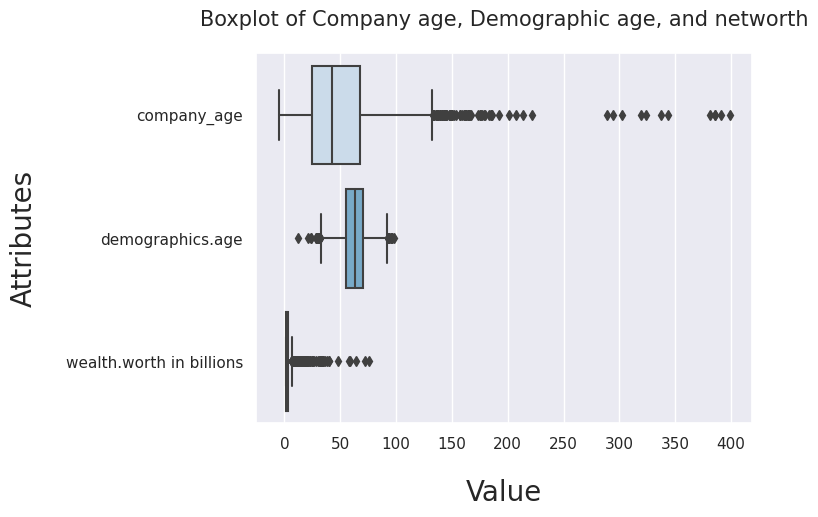

In [ ]:
#create a plot to detect outliers
ax = sns.boxplot(data = df2[["company_age", 'demographics.age','wealth.worth in billions']], orient = "h", palette = "Blues")
#add labels
ax.set_xlabel("Value", fontsize = 20, labelpad = 20)
ax.set_ylabel("Attributes", fontsize = 20, labelpad = 20)
ax.set_title("Boxplot of Company age, Demographic age, and networth", fontsize = 15,
            pad = 20)



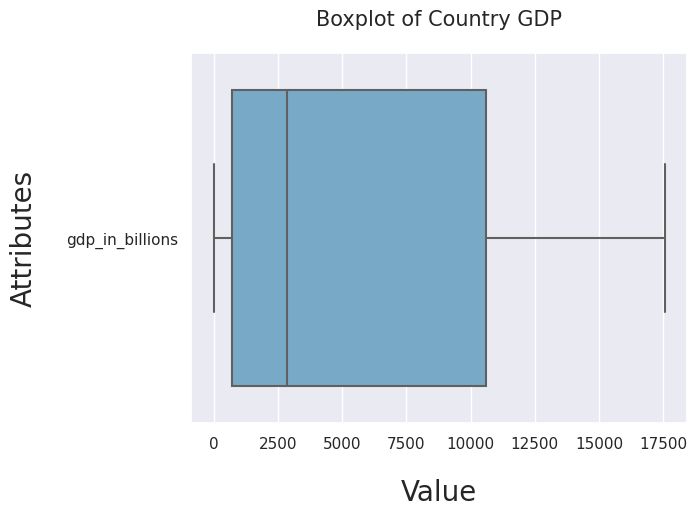

In [ ]:
#create a plot to detect outliers
ax = sns.boxplot(data = df2[[ 'gdp_in_billions']], orient = "h", palette = "Blues")
ax.set_xlabel("Value", fontsize = 20, labelpad = 20)
ax.set_ylabel("Attributes", fontsize = 20, labelpad = 20)
ax.set_title("Boxplot of Country GDP", fontsize = 15,
            pad = 20)

fname = "Boxplo2.png"
plt.savefig(fname, dpi=100)

In [ ]:
#Identifying Outliers
def IQR_bounds(dataframe, column_name, multiple):

    lower_quantile = dataframe[column_name].quantile(0.25)
    upper_quantile = dataframe[column_name].quantile(0.75)

    IQR = upper_quantile - lower_quantile

    lower_bound = lower_quantile - multiple * IQR
    upper_bound = upper_quantile + multiple * IQR

    return lower_bound, upper_bound
columns = ["company_age", 'demographics.age','wealth.worth in billions']
column_bounds = {}
for column in columns:
    lower_bound, upper_bound =  IQR_bounds(df2, column, 1.5)
    column_bounds[column] = [lower_bound, upper_bound]
df2_IQR_AD = df2[(df2["company_age"] < column_bounds["company_age"][0]) |
                         (df2["company_age"] > column_bounds["company_age"][1]) |
                         (df2["demographics.age"] < column_bounds["demographics.age"][0]) |
                         (df2["demographics.age"] > column_bounds["demographics.age"][1]) |
                         (df2["wealth.worth in billions"] < column_bounds["wealth.worth in billions"][0]) |
                         (df2["wealth.worth in billions"] > column_bounds["wealth.worth in billions"][1])]
df2_IQR_AD.shape

(377, 15)

In [ ]:
outliers_list = list(df2_IQR_AD.index.values)
print(outliers_list,end = '')

[0, 1, 2, 3, 4, 5, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 49, 50, 52, 53, 54, 56, 58, 59, 61, 62, 63, 65, 67, 68, 69, 71, 73, 74, 76, 77, 79, 80, 81, 83, 85, 86, 88, 89, 91, 92, 93, 94, 95, 96, 97, 101, 103, 104, 105, 107, 108, 112, 113, 115, 116, 118, 119, 120, 121, 124, 125, 126, 127, 133, 134, 137, 141, 143, 146, 150, 152, 155, 158, 161, 165, 167, 172, 174, 175, 176, 179, 184, 185, 186, 194, 196, 198, 200, 203, 206, 207, 215, 217, 219, 220, 221, 228, 229, 233, 234, 240, 242, 250, 252, 253, 254, 255, 260, 261, 264, 265, 270, 272, 277, 278, 279, 281, 284, 285, 290, 291, 292, 294, 295, 296, 302, 303, 306, 307, 308, 309, 319, 320, 321, 331, 332, 334, 335, 336, 339, 340, 341, 342, 346, 355, 356, 357, 360, 361, 364, 366, 367, 368, 369, 370, 371, 372, 373, 376, 379, 386, 391, 396, 397, 400, 401, 402, 403, 408, 410, 411, 412, 413, 426, 427, 428, 429, 430, 431, 441, 443, 444,

In [ ]:
df2.drop(outliers_list, axis = 0, inplace = True)

In [ ]:
# Exploring the PDF of the numeric values and removing outliers

<ipython-input-61-060b4546076c>:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df2['company_age'])


<Axes: xlabel='company_age', ylabel='Density'>

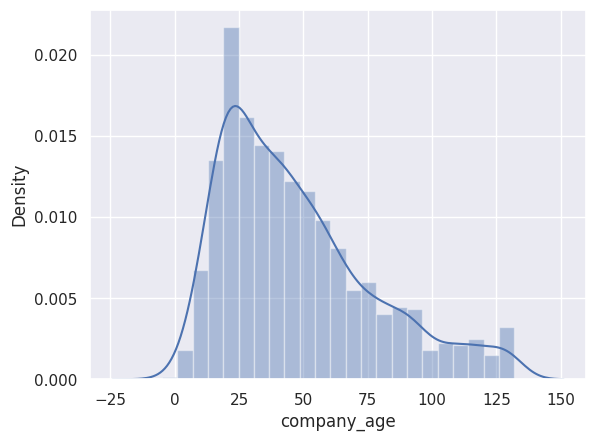

In [ ]:
sns.distplot(df2['company_age'])

In [ ]:
#Removing outliers from the company age column

df2 =df2[df2['company_age']>0]
df2.shape

(2171, 15)

<ipython-input-63-2a3a2ddf4cd7>:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df2['demographics.age'])


<Axes: xlabel='demographics.age', ylabel='Density'>

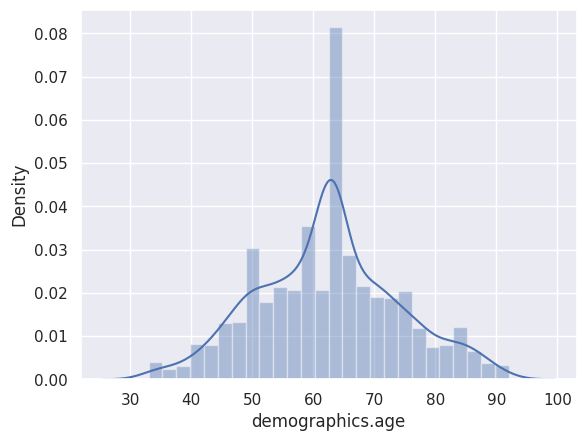

In [ ]:
sns.distplot(df2['demographics.age'])

<ipython-input-64-a8c008971d2c>:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df2['wealth.worth in billions'])


<Axes: xlabel='wealth.worth in billions', ylabel='Density'>

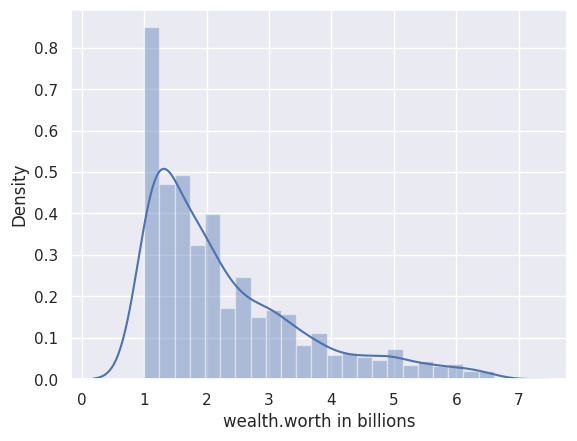

In [ ]:
sns.distplot(df2['wealth.worth in billions'])

In [ ]:
df2['log_of_net_worth_in_billions'] = np.log(df2['wealth.worth in billions'])

<ipython-input-66-f78dbbf0d9f7>:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df2['log_of_net_worth_in_billions'])


<Axes: xlabel='log_of_net_worth_in_billions', ylabel='Density'>

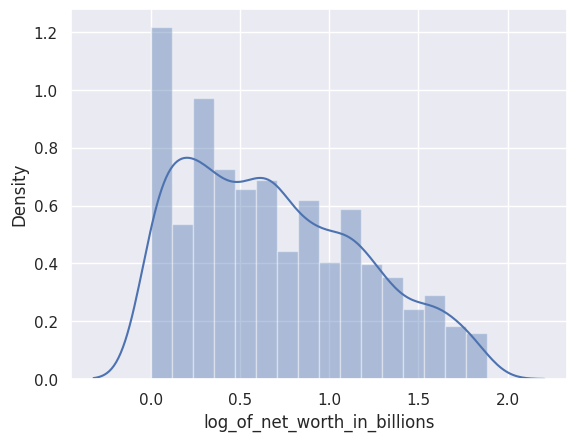

In [ ]:
sns.distplot(df2['log_of_net_worth_in_billions'])

<ipython-input-67-3864791af2ed>:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df2['gdp_in_billions'])


<Axes: xlabel='gdp_in_billions', ylabel='Density'>

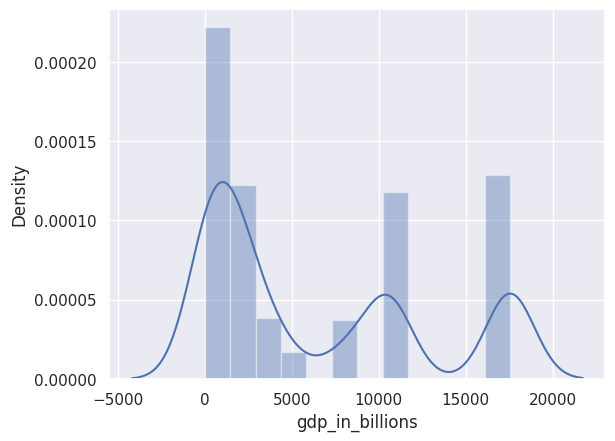

In [ ]:
sns.distplot(df2['gdp_in_billions'])

In [ ]:
df2['log_of_gdp_in_billions'] = np.log(df2['gdp_in_billions'])

<ipython-input-69-54c7729cfa71>:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df2['log_of_gdp_in_billions'])


<Axes: xlabel='log_of_gdp_in_billions', ylabel='Density'>

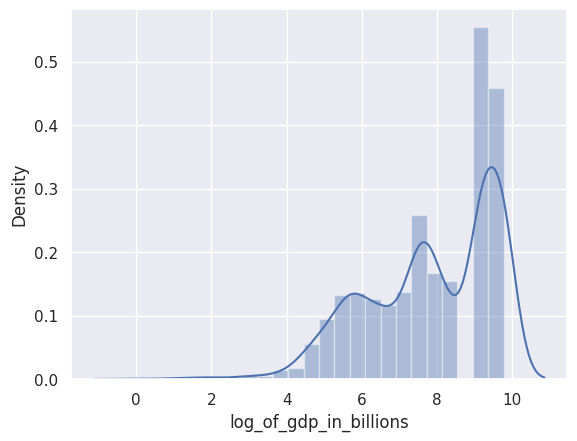

In [ ]:
sns.distplot(df2['log_of_gdp_in_billions'])

In [ ]:
dist_df = df2[['log_of_gdp_in_billions', 'log_of_net_worth_in_billions', 'company_age', 'demographics.age','year']]

In [ ]:
dist_df_melt = dist_df.melt(id_vars='year')
dist_df_melt.head()

,year,variable,value
0,1996,log_of_gdp_in_billions,5.983936
1,1996,log_of_gdp_in_billions,8.999619
2,1996,log_of_gdp_in_billions,6.401917
3,1996,log_of_gdp_in_billions,7.383989
4,1996,log_of_gdp_in_billions,4.615121


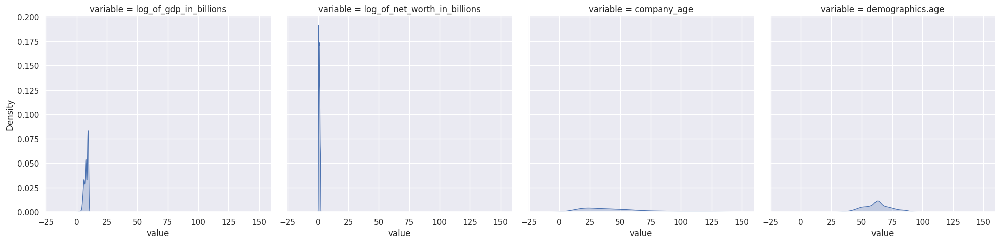

In [ ]:
sns.displot(
    data=dist_df_melt,
    x='value',
    kind='kde',
    fill=True,
    col='variable'
)

In [ ]:
# Dropping more unneeded columns
df2 = df2.drop(columns=['wealth.how.industry', 'location.gdp', 'rank',
                  'company.founded','year','How.wealth.was.gained', 'location.region','wealth.worth in billions','gdp_in_billions','company.type'])

In [ ]:
# Checking for multicolinearity
"""f, (ax1, ax2, ax3, ax4) = plt.subplots(1,4,sharey = True, figsize = (14, 3))
ax1.distplot(df2['log_of_net_worth_in_billions'])
ax1.set_title('networth and year')
ax2.distplot(df2['demographics.age'])
ax2.set_title('demographics.age and networth')
ax3.distplot(df2['company_age'])
ax3.set_title('company_age and networth')
ax4.distplot(df2['log_of_gdp_in_billions'])
ax4.set_title('gdp_in_billions and networth')"""

plt.show()

In [ ]:
df2.describe().T

,count,mean,std,min,25%,50%,75%,max
demographics.age,2171.0,62.390603,11.536014,33.000000,55.000000,63.000000,70.000000,92.000000
company_age,2171.0,47.444956,29.625078,2.000000,24.000000,41.000000,63.000000,132.000000
log_of_net_worth_in_billions,2171.0,0.698925,0.495317,0.000000,0.262364,0.641854,1.064711,1.887070
log_of_gdp_in_billions,2171.0,7.843504,1.687937,-0.047958,6.588291,7.957165,9.268609,9.772848


In [ ]:
# Creating dummy variables with our categorical datasets
df2 =pd.get_dummies(df2,drop_first=True)
df2

,demographics.age,company_age,log_of_net_worth_in_billions,log_of_gdp_in_billions,demographics.gender_male,wealth.type_founder non-finance,wealth.type_inherited,wealth.type_privatized and resources,wealth.type_self-made finance,wealth.how.category_New Sectors,wealth.how.category_Non-Traded Sectors,wealth.how.category_Other,wealth.how.category_Resource Related,wealth.how.category_Traded Sectors,wealth.how.category_Trucking,wealth.how.category_energy
51,56.0,6,1.808289,5.983936,1,0,0,1,0,0,1,0,0,0,0,0
55,51.0,19,1.791759,8.999619,1,1,0,0,0,1,0,0,0,0,0,0
57,63.0,50,1.774952,6.401917,1,0,0,0,1,0,0,0,0,0,0,0
60,63.0,35,1.740466,7.383989,1,1,0,0,0,0,1,0,0,0,0,0
64,73.0,16,1.740466,4.615121,1,0,0,0,1,0,0,0,0,0,0,0
66,55.0,48,1.740466,4.568516,1,0,1,0,0,0,0,0,0,0,0,0
70,70.0,67,1.704748,5.075174,1,0,1,0,0,0,0,0,0,0,0,0
72,85.0,39,1.704748,5.799093,1,1,0,0,0,1,0,0,0,0,0,0
75,58.0,32,1.667707,8.999619,1,1,0,0,0,0,0,0,0,1,0,0
78,52.0,46,1.648659,7.824046,1,0,1,0,0,0,1,0,0,0,0,0


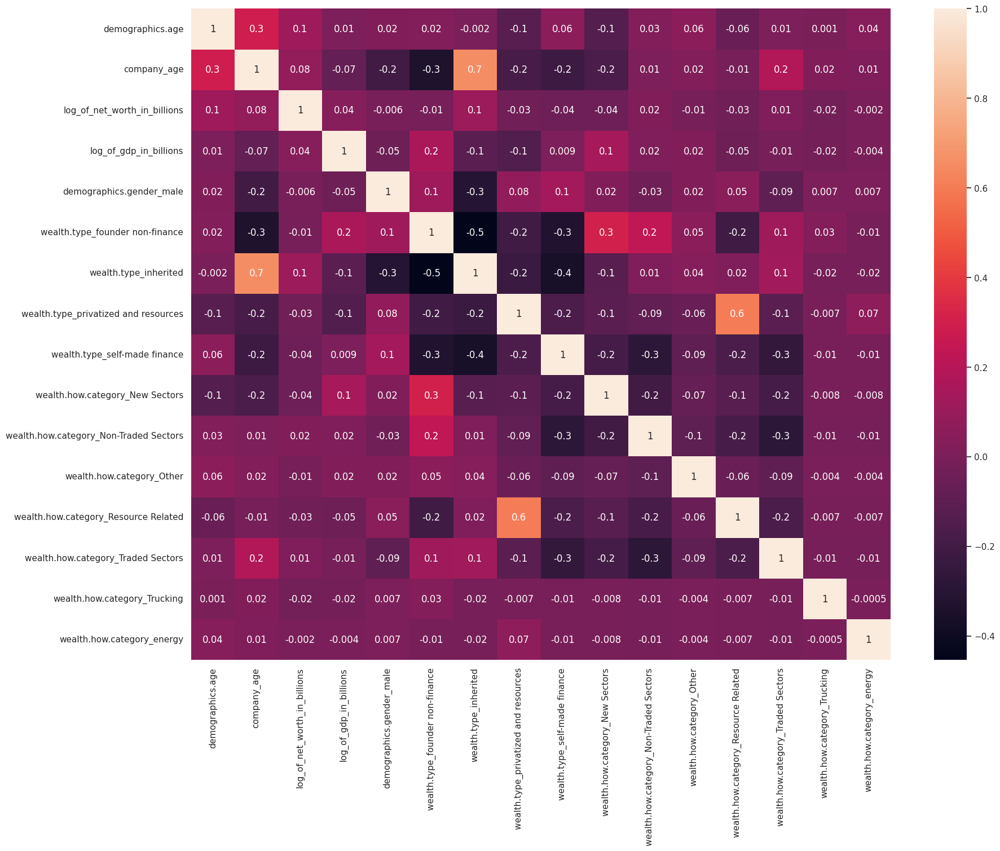

In [ ]:
# Correlation of the dataset
corr = df2.corr()
corr
plt.figure(figsize=(20,15))
sns.heatmap(data=corr, annot=True,fmt='.0g' )

fname1 = "Corr3.png"
plt.savefig(fname1, bbox_inches='tight', dpi=100)

#image_format = 'eps'
#image_name = 'corr2.eps'

#plt.savefig(image_name, format=image_format, dpi=1200)

<Figure size 2000x1500 with 0 Axes>

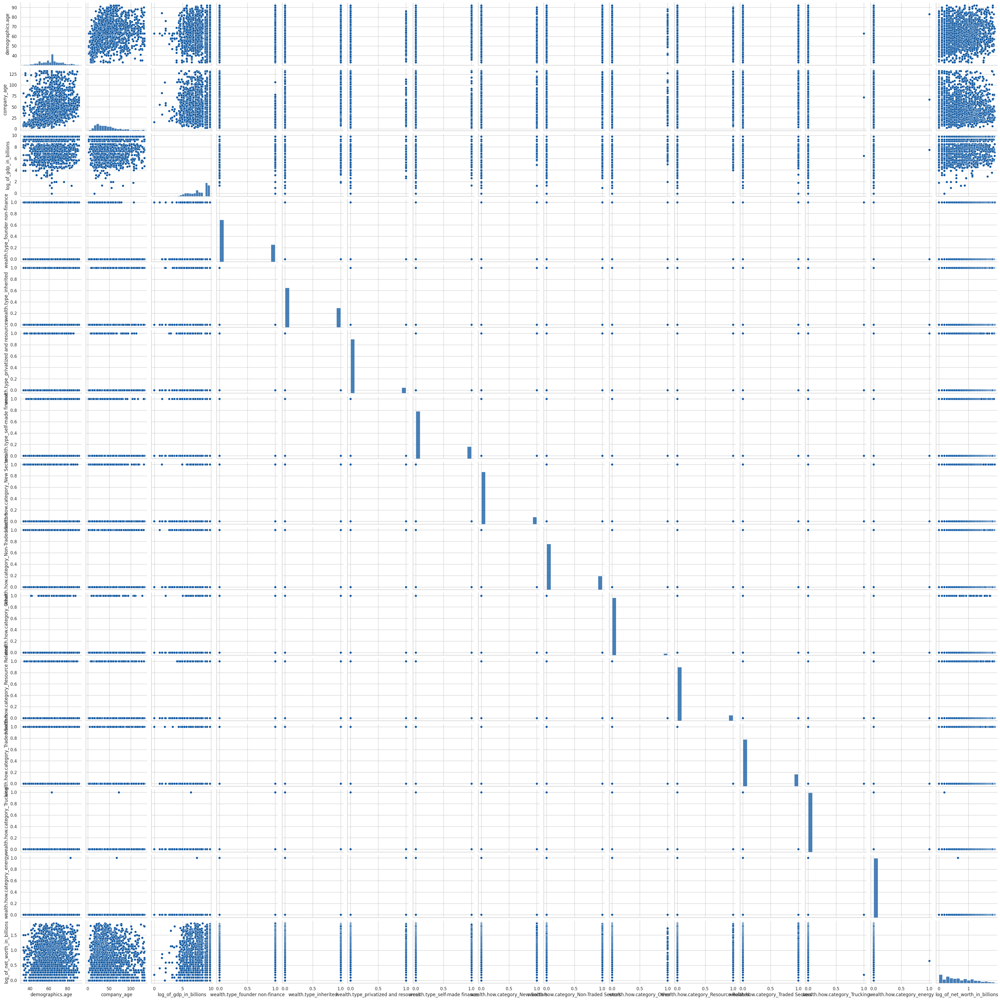

In [ ]:
plt.figure(figsize=(20,15))
sns.pairplot(df2[['demographics.age', 'company_age',
       'log_of_gdp_in_billions',
       'wealth.type_founder non-finance',
       'wealth.type_inherited', 'wealth.type_privatized and resources',
       'wealth.type_self-made finance', 'wealth.how.category_New Sectors',
       'wealth.how.category_Non-Traded Sectors', 'wealth.how.category_Other',
       'wealth.how.category_Resource Related',
       'wealth.how.category_Traded Sectors', 'wealth.how.category_Trucking',
       'wealth.how.category_energy','log_of_net_worth_in_billions']]) # checking for linearity

fname1200 = "linera.png"
plt.savefig(fname1200, bbox_inches='tight', dpi=100)

In [ ]:
from seaborn.regression import statsmodels
#Running Multi linear regression
import statsmodels.api as sm
from statsmodels.formula.api import ols

y = df2['log_of_net_worth_in_billions']

x1 = df2[['demographics.age', 'company_age',
       'log_of_gdp_in_billions','demographics.gender_male',
       'wealth.type_founder non-finance',
       'wealth.type_inherited', 'wealth.type_privatized and resources',
       'wealth.type_self-made finance', 'wealth.how.category_New Sectors',
       'wealth.how.category_Non-Traded Sectors', 'wealth.how.category_Other',
       'wealth.how.category_Resource Related',
       'wealth.how.category_Traded Sectors', 'wealth.how.category_Trucking',
       'wealth.how.category_energy']]

x = sm.add_constant(x1)
model = sm.OLS(y,x).fit()

model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                 OLS Regression Results                                 
========================================================================================
Dep. Variable:     log_of_net_worth_in_billions   R-squared:                       0.040
Model:                                      OLS   Adj. R-squared:                  0.033
Method:                           Least Squares   F-statistic:                     6.014
Date:                          Mon, 15 May 2023   Prob (F-statistic):           1.78e-12
Time:                                  07:53:01   Log-Likelihood:                -1510.3
No. Observations:                          2171   AIC:                             3053.
Df Residuals:                              2155   BIC:                             3143.
Df Model:                                    15                                         
Covariance Type:                      nonrobust                                         
==========================================================================================================
                                             coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------------------------
const                                      0.1104      0.105      1.050      0.294      -0.096       0.317
demographics.age                           0.0054      0.001      5.386      0.000       0.003       0.007
company_age                               -0.0006      0.001     -1.157      0.247      -0.002       0.000
log_of_gdp_in_billions                     0.0187      0.006      2.911      0.004       0.006       0.031
demographics.gender_male                   0.0623      0.038      1.626      0.104      -0.013       0.137
wealth.type_founder non-finance            0.1277      0.043      2.970      0.003       0.043       0.212
wealth.type_inherited                      0.2462      0.049      5.060      0.000       0.151       0.342
wealth.type_privatized and resources       0.1661      0.062      2.668      0.008       0.044       0.288
wealth.type_self-made finance              0.0161      0.059      0.271      0.786      -0.100       0.132
wealth.how.category_New Sectors           -0.1114      0.050     -2.211      0.027      -0.210      -0.013
wealth.how.category_Non-Traded Sectors    -0.0649      0.043     -1.522      0.128      -0.149       0.019
wealth.how.category_Other                 -0.1386      0.069     -2.020      0.043      -0.273      -0.004
wealth.how.category_Resource Related      -0.1489      0.052     -2.844      0.004      -0.252      -0.046
wealth.how.category_Traded Sectors        -0.0706      0.043     -1.656      0.098      -0.154       0.013
wealth.how.category_Trucking              -0.5367      0.490     -1.096      0.273      -1.497       0.423
wealth.how.category_energy                -0.2467      0.490     -0.503      0.615      -1.208       0.715
==============================================================================
Omnibus:                      156.445   Durbin-Watson:                   0.274
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              109.989
Skew:                           0.443   Prob(JB):                     1.31e-24
Kurtosis:                       2.344   Cond. No.                     3.85e+03
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 3.85e+03. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [ ]:
fitted_values = model.predict(x)

In [ ]:
# Calculate Residuals
residuals = model.resid

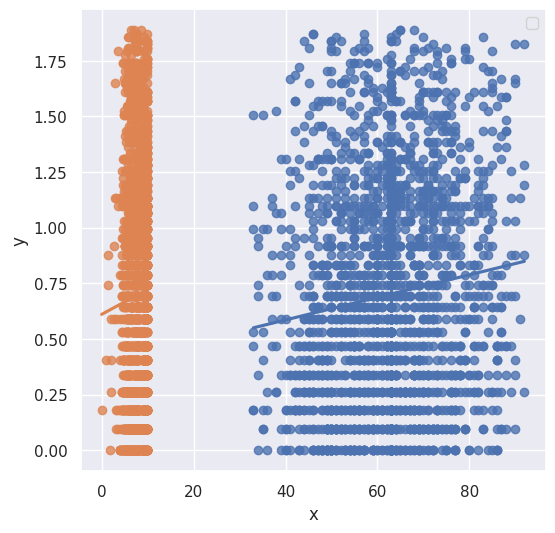

In [ ]:
#Regression plot

"""sns.regplot(x = ['demographics.age', 'log_of_gdp_in_billions',
                 'wealth.type_founder non-finance',
                 'wealth.type_inherited',
                 'wealth.type_privatized and resources', 'wealth.how.category_New Sectors',
                 'wealth.how.category_Other','wealth.how.category_Resource Related','wealth.how.category_Traded Sectors'],
            y = 'log_of_net_worth_in_billions', data = df2)"""

fig, ax = plt.subplots(figsize=(6, 6))

# add the plots for each dataframe
sns.regplot(x='demographics.age', y='log_of_net_worth_in_billions', data=df2, fit_reg=True, ci=None, ax=ax)
sns.regplot(x='log_of_gdp_in_billions', y='log_of_net_worth_in_billions', data=df2, fit_reg=True, ci=None, ax=ax)
ax.set(ylabel='y', xlabel='x')
ax.legend()
plt.show()

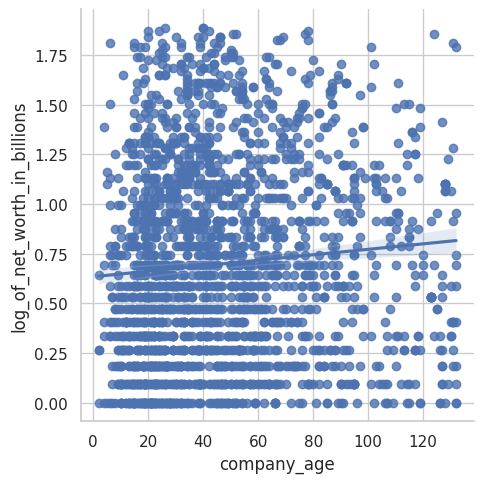

In [ ]:
sns.set_style('whitegrid')
sns.lmplot(x ='company_age', y ='log_of_net_worth_in_billions', data = df2)

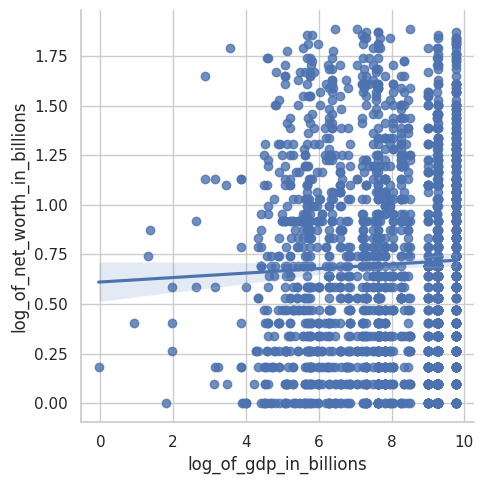

In [ ]:
sns.lmplot(x ='log_of_gdp_in_billions', y ='log_of_net_worth_in_billions', data = df2)

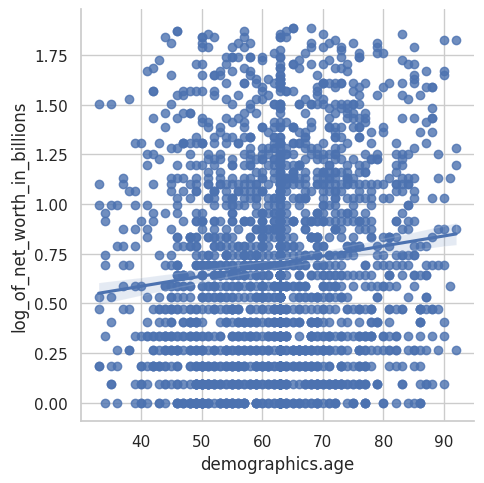

In [ ]:
sns.lmplot(x ='demographics.age', y ='log_of_net_worth_in_billions', data = df2)

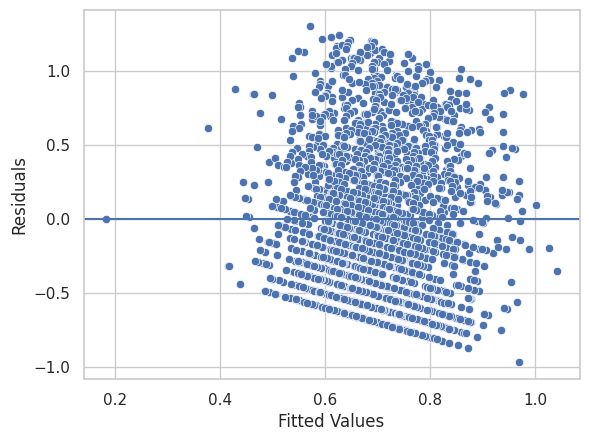

In [ ]:
fig = sns.scatterplot(x = fitted_values, y = residuals)
fig.axhline(0)
fig.set_xlabel('Fitted Values')
fig.set_ylabel('Residuals')
plt.show()

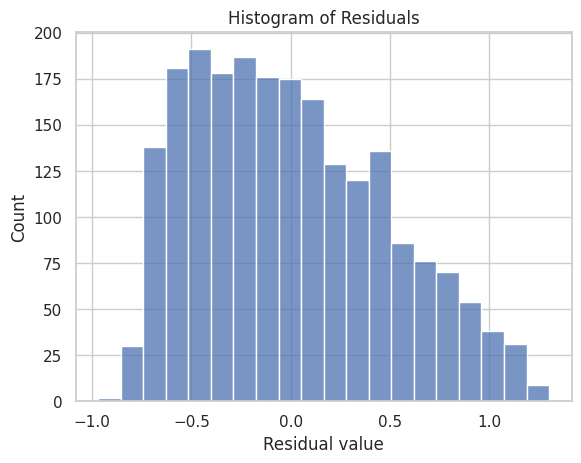

In [ ]:
fig = sns.histplot(residuals)
fig.set_xlabel("Residual value")
fig.set_title("Histogram of Residuals")
plt.show()

Data Analysis

What are the top 10 countries with the highest number of billionaires?
What industries/sectors are most successful?
What are the main industries with the highest number of women billionaires?
What age range represents the highest and lowest number of billionaires?


What are the top 10 countries with the highest number of billionaires?

In [ ]:
df_Ryears = df1.groupby(['year','location.citizenship']).count().reset_index()
dffiltered = df_Ryears.sort_values('name',ascending = False).groupby('year').head(10) # Filterig for the top 10 countries
dffiltered

,year,location.citizenship,name,rank,company.founded,company.name,company.relationship,company.sector,company.type,demographics.age,demographics.gender,location.country code,location.gdp,location.region,wealth.type,wealth.worth in billions,wealth.how.category,wealth.how.from emerging,wealth.how.industry,wealth.how.inherited,wealth.how.was founder,wealth.how.was political,demographics_composition,How.wealth.was.gained
152,2014,United States,499,499,499,495,499,499,499,499,499,499,499,499,499,499,499,499,499,499,499,499,499,499
84,2001,United States,269,269,269,263,268,268,269,269,269,269,269,269,269,269,269,269,269,269,269,269,269,269
95,2014,China,152,152,152,152,151,152,152,152,152,152,152,152,152,152,152,152,152,152,152,152,152,152
38,1996,United States,135,135,135,135,135,135,135,135,135,135,135,135,135,135,135,135,135,135,135,135,135,135
134,2014,Russia,111,111,111,110,111,111,111,111,111,111,111,111,111,111,111,111,111,111,111,111,111,111
104,2014,Germany,85,85,85,85,85,85,85,85,85,85,85,85,85,85,85,85,85,85,85,85,85,85
92,2014,Brazil,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65,65
108,2014,India,56,56,56,56,56,56,56,56,56,56,56,56,56,56,56,56,56,56,56,56,56,56
151,2014,United Kingdom,47,47,47,47,47,47,47,47,47,47,47,47,47,47,47,47,47,47,47,47,47,47
10,1996,Germany,47,47,47,42,32,42,47,47,32,47,47,47,47,47,47,47,47,47,47,47,47,47


In [ ]:
list_countries = list(set(dffiltered['location.citizenship'])) # List of the countries from the filter table
list_countries

['Switzerland',
 'Mexico',
 'Hong Kong',
 'Malaysia',
 'Canada',
 'Thailand',
 'Russia',
 'China',
 'Brazil',
 'India',
 'France',
 'United States',
 'Japan',
 'Italy',
 'United Kingdom',
 'Germany']

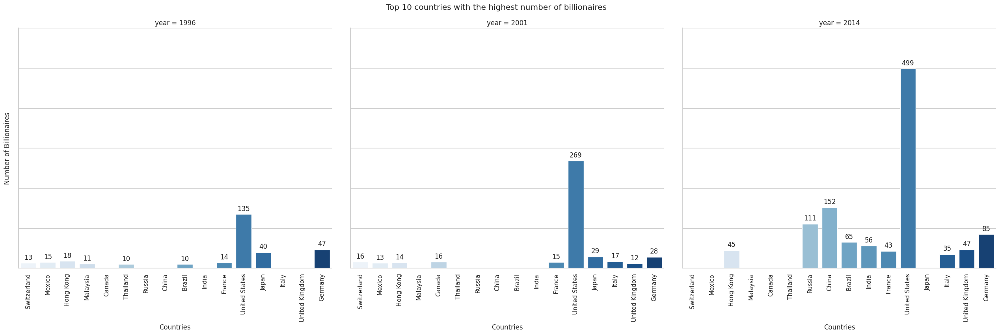

In [ ]:

T10Cs = sns.FacetGrid(dffiltered, col="year", height=7.2, aspect=1.2, despine = True)
T10Cs = T10Cs.map(sns.barplot, 'location.citizenship', 'name', palette="Blues", errorbar=None, order = list_countries)


T10Cs.set_xticklabels(rotation = 90)
T10Cs.set_yticklabels(labels= None)
T10Cs.set_xlabels(label="Countries")
T10Cs.set_ylabels(label="Number of Billionaires")
T10Cs.fig.suptitle('Top 10 countries with the highest number of billionaires',
               y=1.03)
for ax in T10Cs.axes.ravel():
  for p in ax.patches:
    ax.annotate(format(p.get_height(), '.0f'), (p.get_x() + p.get_width() / 2., p.get_height()), ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points')

fname3 = "T101.png"
plt.savefig(fname3, bbox_inches='tight', dpi=100)
plt.show() # plotting the charts

Q2: What industries/sectors are most successful?

In [ ]:
df_sucsec = df1.groupby(['year', 'wealth.how.industry']).count().reset_index()
dffiltered2 = df_sucsec.sort_values('name',ascending = False).groupby('year').head(13000) # Grouping and sorting the tables

dffiltered2

,year,wealth.how.industry,name,rank,company.founded,company.name,company.relationship,company.sector,company.type,demographics.age,demographics.gender,location.citizenship,location.country code,location.gdp,location.region,wealth.type,wealth.worth in billions,wealth.how.category,wealth.how.from emerging,wealth.how.inherited,wealth.how.was founder,wealth.how.was political,demographics_composition,How.wealth.was.gained
33,2014,Consumer,291,291,291,291,291,291,291,291,291,291,291,291,291,291,291,291,291,291,291,291,291,291
43,2014,Real Estate,191,191,191,186,190,191,191,191,191,191,191,191,191,191,191,191,191,191,191,191,191,191
44,2014,Retail,175,175,175,175,175,175,175,175,175,175,175,175,175,175,175,175,175,175,175,175,175,175
34,2014,Diversified financial,132,132,132,132,131,132,132,132,132,132,132,132,132,132,132,132,132,132,132,132,132,132
45,2014,Technology-Computer,131,131,131,131,131,131,131,131,131,131,131,131,131,131,131,131,131,131,131,131,131,131
39,2014,Money Management,122,122,122,122,122,122,122,122,122,122,122,122,122,122,122,122,122,122,122,122,122,122
37,2014,Media,104,104,104,104,104,104,104,104,104,104,104,104,104,104,104,104,104,104,104,104,104,104
17,2001,Consumer,94,94,94,94,94,94,94,94,94,94,94,94,94,94,94,94,94,94,94,94,94,94
1,1996,Consumer,88,88,88,82,78,82,88,88,78,88,88,88,88,88,88,88,88,88,88,88,88,88
35,2014,Energy,87,87,87,87,87,87,87,87,87,87,87,87,87,87,87,87,87,87,87,87,87,87


In [ ]:
df_pivot2 = pd.pivot_table(dffiltered2,
                          values='name',
                          index= 'wealth.how.industry',
                          columns= 'year') # Pivoting the grouped and sorted table
df_pivot2

year,1996,2001,2014
wealth.how.industry,,,
Construction,17.0,20.0,61.0
Consumer,88.0,94.0,291.0
Diversified financial,26.0,11.0,132.0
Energy,15.0,30.0,87.0
Hedge funds,9.0,15.0,43.0
Media,42.0,74.0,104.0
Mining and metals,12.0,10.0,69.0
Money Management,58.0,69.0,122.0
Non-consumer industrial,16.0,8.0,83.0


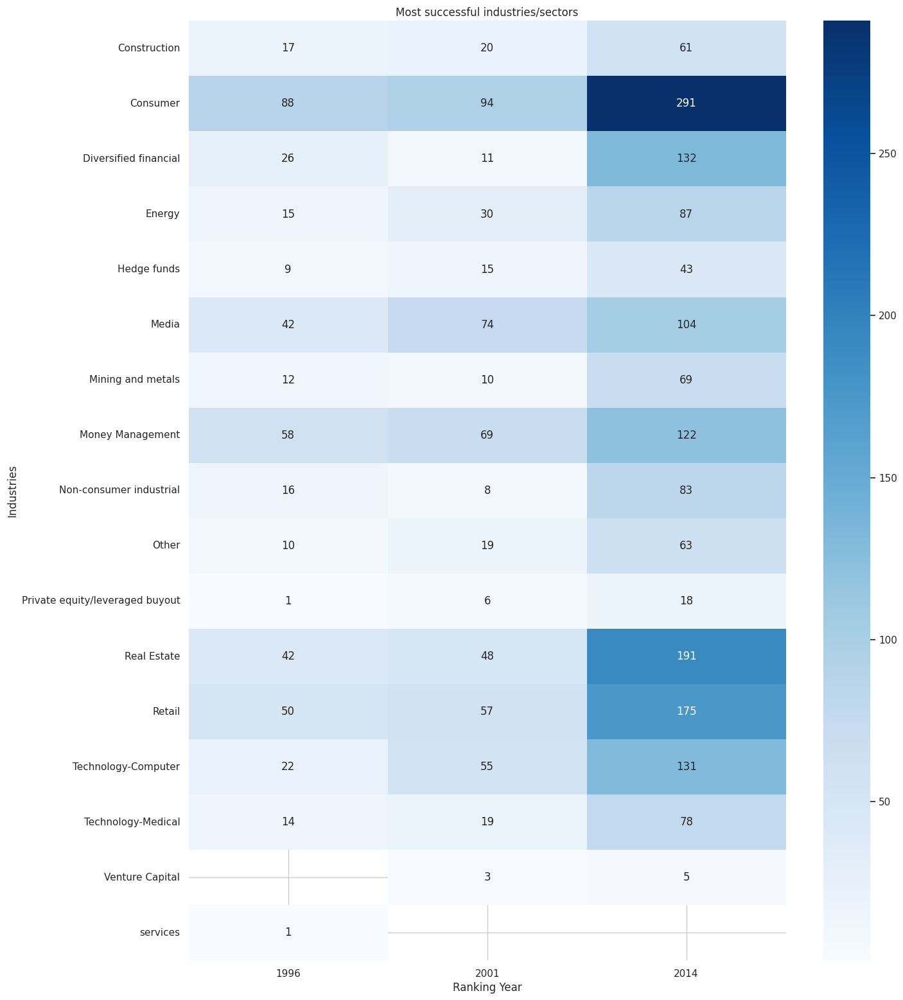

In [ ]:
plt.figure(figsize = (15,19))
plt.title('Most successful industries/sectors')

sns.heatmap(df_pivot2, annot=True, cmap='Blues', fmt= '.4g',)
plt.xlabel('Ranking Year')
plt.ylabel('Industries')

fname2 = "MSI2.png"
plt.savefig(fname2, bbox_inches='tight', dpi=100)
plt.show() # Ploting the chart

# Q3: What are the main industries with the highest number of women  billionaires?

In [ ]:
df_FemaleB = df1.loc[df1['demographics.gender'] =='female'] # Creating a new df for only the female gender
df_FemaleB

,name,rank,year,company.founded,company.name,company.relationship,company.sector,company.type,demographics.age,demographics.gender,location.citizenship,location.country code,location.gdp,location.region,wealth.type,wealth.worth in billions,wealth.how.category,wealth.how.from emerging,wealth.how.industry,wealth.how.inherited,wealth.how.was founder,wealth.how.was political,demographics_composition,How.wealth.was.gained
26,Christy Walton,9,2014,1962,Walmart,relation,retail,new,59,female,United States,USA,1.755068e+13,North America,inherited,36.7,Non-Traded Sectors,True,Retail,spouse/widow,True,True,female,Inherited
28,Alice Walton,10,2001,1962,Walmart,relation,retail,new,52,female,United States,USA,1.060000e+13,North America,inherited,18.5,Non-Traded Sectors,True,Retail,father,True,True,female,Inherited
29,Helen Walton,10,2001,1962,Walmart,relation,retail,new,81,female,United States,USA,1.060000e+13,North America,inherited,18.5,Traded Sectors,True,Consumer,spouse/widow,True,True,female,Inherited
31,Johanna Quandt,11,1996,1916,BMW,relation,cars,new,68,female,Germany,DEU,2.500000e+12,Europe,inherited,8.1,Traded Sectors,True,Consumer,spouse/widow,True,True,female,Inherited
32,Liliane Bettencourt,11,2014,1909,L'Oreal,relation,cosmetics,new,91,female,France,FRA,2.855964e+12,Europe,inherited,34.5,Traded Sectors,True,Consumer,father,True,True,female,Inherited
34,Johanna Quandt,12,2001,1916,BMW,relation,cars,new,73,female,Germany,DEU,1.950000e+12,Europe,inherited,17.8,Traded Sectors,True,Consumer,spouse/widow,True,True,female,Inherited
38,Alice Walton,13,2014,1962,Walmart,relation,retail,new,64,female,United States,USA,1.755068e+13,North America,inherited,34.3,Non-Traded Sectors,True,Retail,father,True,True,female,Inherited
43,Liliane Bettencourt,15,2001,1909,L'Oreal,relation,cosmetics,new,78,female,France,FRA,1.380000e+12,Europe,inherited,15.6,Traded Sectors,True,Consumer,father,True,True,female,Inherited
61,Anne Cox Chambers,21,2001,1898,Cox Enterprises,relation,media,acquired,81,female,United States,USA,1.060000e+13,North America,inherited,11.7,Non-Traded Sectors,True,Media,father,True,True,female,Inherited
62,Barbara Cox Anthony,21,2001,1898,Cox Enterprises,relation,media,acquired,77,female,United States,USA,1.060000e+13,North America,inherited,11.7,Non-Traded Sectors,True,Media,father,True,True,female,Inherited


In [ ]:
df_FB = df_FemaleB.groupby(['year', 'wealth.how.industry']).count().reset_index()
dffiltered3 = df_FB.sort_values('name',ascending = False).groupby('year').head(13000)  # Grouping and sorting the table

dffiltered3

,year,wealth.how.industry,name,rank,company.founded,company.name,company.relationship,company.sector,company.type,demographics.age,demographics.gender,location.citizenship,location.country code,location.gdp,location.region,wealth.type,wealth.worth in billions,wealth.how.category,wealth.how.from emerging,wealth.how.inherited,wealth.how.was founder,wealth.how.was political,demographics_composition,How.wealth.was.gained
18,2014,Consumer,45,45,45,45,45,45,45,45,45,45,45,45,45,45,45,45,45,45,45,45,45,45
26,2014,Real Estate,21,21,21,21,21,21,21,21,21,21,21,21,21,21,21,21,21,21,21,21,21,21
27,2014,Retail,20,20,20,20,20,20,20,20,20,20,20,20,20,20,20,20,20,20,20,20,20,20
23,2014,Money Management,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15
10,2001,Consumer,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15
24,2014,Non-consumer industrial,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13,13
1,1996,Consumer,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12
21,2014,Media,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11
19,2014,Diversified financial,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11
28,2014,Technology-Computer,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10,10


In [ ]:
list_industries = list(set(dffiltered3['wealth.how.industry'])) # List of industries
list_industries

['Non-consumer industrial',
 'Media',
 'Consumer',
 'Construction',
 'Other',
 'Technology-Medical',
 'Mining and metals',
 'Retail',
 'Technology-Computer',
 'Real Estate',
 'Energy',
 'Money Management',
 'Diversified financial']

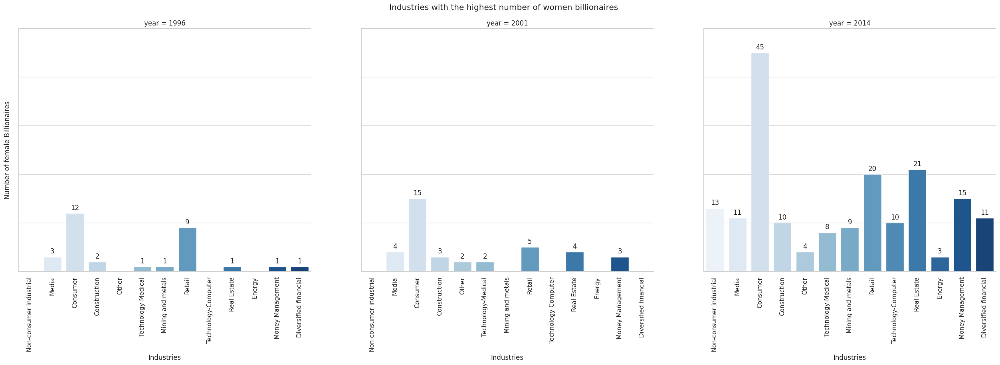

In [ ]:
FB_Ind = sns.FacetGrid(dffiltered3, col="year", height=7.2, aspect=1.2, despine = True)
FB_Ind = FB_Ind.map(sns.barplot, 'wealth.how.industry', 'name', palette="Blues", errorbar=None, order = list_industries)


FB_Ind.set_xticklabels(rotation = 90)
FB_Ind.set_yticklabels(labels= None)
FB_Ind.set_xlabels(label="Industries")
FB_Ind.set_ylabels(label="Number of female Billionaires")
FB_Ind.fig.suptitle('Industries with the highest number of women billionaires',
               y=1.03)
for ax in FB_Ind.axes.ravel():
  for p in ax.patches:
    ax.annotate(format(p.get_height(), '.0f'), (p.get_x() + p.get_width() / 2., p.get_height()), ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points')

fname4 = "FId1.png"
plt.savefig(fname4, bbox_inches='tight', dpi=500)
plt.show() # Plotting the Chart

3B: How female Billionaires made their wealth

Q4: What age range represents the highest and lowest number of billionaires?

In [ ]:
df_FilteredAge= df1.loc[df1['demographics.age'] != 0]
df_FilteredAge['age_group'] = pd.cut(df_FilteredAge['demographics.age'], bins=[0, 17, 18, 24, 25,49,50,100]) # Groupping the age
df_FilteredAge

<ipython-input-98-6d9fbc662ed7>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_FilteredAge['age_group'] = pd.cut(df_FilteredAge['demographics.age'], bins=[0, 17, 18, 24, 25,49,50,100]) # Groupping the age


,name,rank,year,company.founded,company.name,company.relationship,company.sector,company.type,demographics.age,demographics.gender,location.citizenship,location.country code,location.gdp,location.region,wealth.type,wealth.worth in billions,wealth.how.category,wealth.how.from emerging,wealth.how.industry,wealth.how.inherited,wealth.how.was founder,wealth.how.was political,demographics_composition,How.wealth.was.gained,age_group
0,Bill Gates,1,1996,1975,Microsoft,founder,Software,new,40,male,United States,USA,8.100000e+12,North America,founder non-finance,18.5,New Sectors,True,Technology-Computer,not inherited,True,True,male,not inherited,"(25, 49]"
1,Bill Gates,1,2001,1975,Microsoft,founder,Software,new,45,male,United States,USA,1.060000e+13,North America,founder non-finance,58.7,New Sectors,True,Technology-Computer,not inherited,True,True,male,not inherited,"(25, 49]"
2,Bill Gates,1,2014,1975,Microsoft,founder,Software,new,58,male,United States,USA,1.755068e+13,North America,founder non-finance,76.0,New Sectors,True,Technology-Computer,not inherited,True,True,male,not inherited,"(50, 100]"
3,Warren Buffett,2,1996,1962,Berkshire Hathaway,founder,Finance,new,65,male,United States,USA,8.100000e+12,North America,founder non-finance,15.0,Traded Sectors,True,Consumer,not inherited,True,True,male,not inherited,"(50, 100]"
4,Warren Buffett,2,2001,1962,Berkshire Hathaway,founder,Finance,new,70,male,United States,USA,1.060000e+13,North America,founder non-finance,32.3,Traded Sectors,True,Consumer,not inherited,True,True,male,not inherited,"(50, 100]"
5,Carlos Slim Helu,2,2014,1990,Telmex,founder,Communications,privatized,74,male,Mexico,MEX,1.315351e+12,Latin America,privatized and resources,72.0,Non-Traded Sectors,True,Media,not inherited,True,True,male,not inherited,"(50, 100]"
7,Paul Allen,3,2001,1975,Microsoft,founder,technology,new,48,male,United States,USA,1.060000e+13,North America,founder non-finance,30.4,New Sectors,True,Technology-Computer,not inherited,True,True,male,not inherited,"(25, 49]"
8,Amancio Ortega,3,2014,1975,Zara,founder,Fashion,new,77,male,Spain,ESP,1.371821e+12,Europe,founder non-finance,64.0,Non-Traded Sectors,True,Retail,not inherited,True,True,male,not inherited,"(50, 100]"
9,Lee Shau Kee,4,1996,1976,Henderson Land Development,founder/chairman,real estate,new,68,male,Hong Kong,HKG,1.600000e+11,East Asia,self-made finance,12.7,Financial,True,Real Estate,not inherited,True,True,male,not inherited,"(50, 100]"
10,Larry Ellison,4,2001,1977,Oracle,founder,software,new,56,male,United States,USA,1.060000e+13,North America,founder non-finance,26.0,New Sectors,True,Technology-Computer,not inherited,True,True,male,not inherited,"(50, 100]"


In [ ]:
df_ageB = df_FilteredAge.groupby(['year', 'age_group']).count().reset_index()
dffiltered4 = df_ageB.sort_values('name',ascending = False).groupby('year').head(13000)  #Grouping and sorting the table

dffiltered4

,year,age_group,name,rank,company.founded,company.name,company.relationship,company.sector,company.type,demographics.age,demographics.gender,location.citizenship,location.country code,location.gdp,location.region,wealth.type,wealth.worth in billions,wealth.how.category,wealth.how.from emerging,wealth.how.industry,wealth.how.inherited,wealth.how.was founder,wealth.how.was political,demographics_composition,How.wealth.was.gained
20,2014,"(50, 100]",1284,1284,1284,1277,1282,1284,1284,1284,1284,1284,1284,1284,1284,1284,1284,1284,1284,1284,1284,1284,1284,1284,1284
13,2001,"(50, 100]",336,336,336,328,334,335,336,336,336,336,336,336,336,336,336,336,336,336,336,336,336,336,336
18,2014,"(25, 49]",259,259,259,258,259,259,259,259,259,259,259,259,259,259,259,259,259,259,259,259,259,259,259
6,1996,"(50, 100]",168,168,168,167,167,168,168,168,168,168,168,168,168,168,168,168,168,168,168,168,168,168,168
11,2001,"(25, 49]",69,69,69,69,69,69,69,69,69,69,69,69,69,69,69,69,69,69,69,69,69,69,69
19,2014,"(49, 50]",46,46,46,46,46,46,46,46,46,46,46,46,46,46,46,46,46,46,46,46,46,46,46
4,1996,"(25, 49]",45,45,45,45,45,45,45,45,45,45,45,45,45,45,45,45,45,45,45,45,45,45,45
12,2001,"(49, 50]",11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11,11
5,1996,"(49, 50]",8,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8,8
2,1996,"(18, 24]",2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2


In [ ]:
list_age_bracket = list(set(dffiltered4['age_group'])).sort()
list_age_bracket

/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:712: UserWarning: Using the barplot function without specifying `order` is likely to produce an incorrect plot.
  warnings.warn(warning)


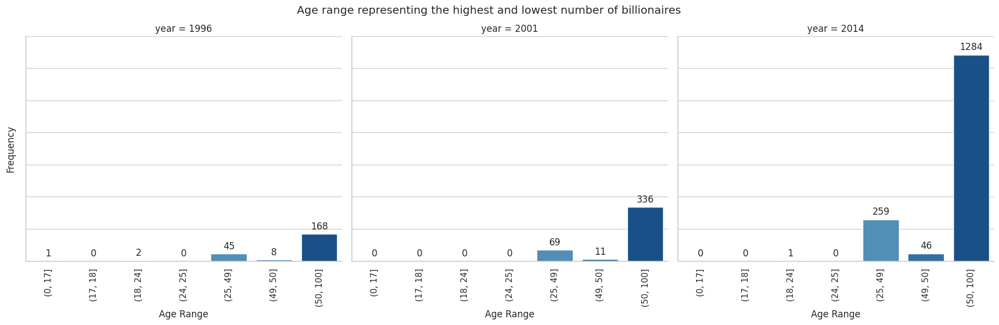

In [ ]:
Age_group = sns.FacetGrid(dffiltered4, col="year", height=5.2, aspect=1.2, despine = True)
Age_group = Age_group.map(sns.barplot, 'age_group', 'name', palette="Blues", errorbar=None)

Age_group.set_xticklabels(rotation = 90)
Age_group.set_yticklabels(labels= None)
Age_group.set_xlabels(label="Age Range")
Age_group.set_ylabels(label="Frequency")
Age_group.fig.suptitle('Age range representing the highest and lowest number of billionaires',
               y=1.03)
for ax in Age_group.axes.ravel():
  for p in ax.patches:
    ax.annotate(format(p.get_height(), '.0f'), (p.get_x() + p.get_width() / 2., p.get_height()), ha = 'center',
                va = 'center', xytext = (0, 10), textcoords = 'offset points')
fname5 = "AGE.png"
plt.savefig(fname5, bbox_inches='tight', dpi=100)
plt.show()

Descriptive Analysis

In [ ]:
df_Num_B = df1.groupby(['year']).count().reset_index()

dff1 = df_Num_B.sort_values('name',ascending = False).groupby('year').head(13000)

dff1

,year,name,rank,company.founded,company.name,company.relationship,company.sector,company.type,demographics.age,demographics.gender,location.citizenship,location.country code,location.gdp,location.region,wealth.type,wealth.worth in billions,wealth.how.category,wealth.how.from emerging,wealth.how.industry,wealth.how.inherited,wealth.how.was founder,wealth.how.was political,demographics_composition,How.wealth.was.gained
2,2014,1653,1653,1653,1645,1651,1653,1653,1653,1653,1653,1653,1653,1653,1653,1653,1653,1653,1653,1653,1653,1653,1653,1653
1,2001,538,538,538,528,534,536,538,538,538,538,538,538,538,538,538,538,538,538,538,538,538,538,538
0,1996,423,423,423,403,383,402,423,423,389,423,423,423,423,423,423,423,423,423,423,423,423,423,423


63.23642134666443
20.581483840942383
16.182096302509308


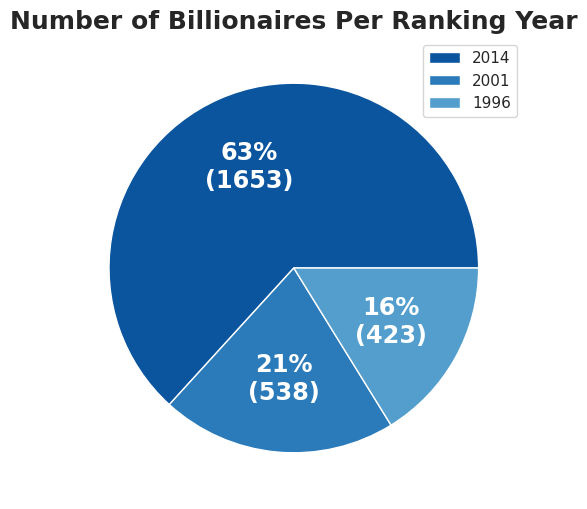

In [ ]:
total = dff1['name'].sum()

def my_autopc_format (pct_value):
  print(pct_value)
  return '{:.0f}%\n({:.0f})'.format(pct_value, total*pct_value/100)


sns.set_palette('Blues_r')
plt.figure(figsize = (8,6))
plt.pie(dff1['name'],
        labels = dff1['year'].values,
        autopct = my_autopc_format,
        textprops = {'size': 'x-large',
                     'fontweight' : 'bold',
                     'rotation': 'horizontal',
                     'color' : 'w'})
plt.legend()
plt.title('Number of Billionaires Per Ranking Year', fontsize =18,
           fontweight = 'bold')

fname6 = "numy.png"
plt.savefig(fname6, bbox_inches='tight', dpi=100)
plt.show()

In [ ]:
df_MF = df1.groupby(['demographics_composition', 'year']).count().reset_index()

dff2 = df_MF.sort_values('name',ascending = False).groupby('year').head(13000)

dff2

,demographics_composition,year,name,rank,company.founded,company.name,company.relationship,company.sector,company.type,demographics.age,demographics.gender,location.citizenship,location.country code,location.gdp,location.region,wealth.type,wealth.worth in billions,wealth.how.category,wealth.how.from emerging,wealth.how.industry,wealth.how.inherited,wealth.how.was founder,wealth.how.was political,How.wealth.was.gained
6,male,2014,1473,1473,1473,1465,1471,1473,1473,1473,1473,1473,1473,1473,1473,1473,1473,1473,1473,1473,1473,1473,1473,1473
5,male,2001,498,498,498,489,495,497,498,498,498,498,498,498,498,498,498,498,498,498,498,498,498,498
4,male,1996,357,357,357,348,348,348,357,357,357,357,357,357,357,357,357,357,357,357,357,357,357,357
3,female,2014,180,180,180,180,180,180,180,180,180,180,180,180,180,180,180,180,180,180,180,180,180,180
2,female,2001,38,38,38,37,37,37,38,38,38,38,38,38,38,38,38,38,38,38,38,38,38,38
0,Family,1996,34,34,34,23,3,22,34,34,0,34,34,34,34,34,34,34,34,34,34,34,34,34
1,female,1996,31,31,31,31,31,31,31,31,31,31,31,31,31,31,31,31,31,31,31,31,31,31
8,married couple,2001,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2
7,married couple,1996,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1


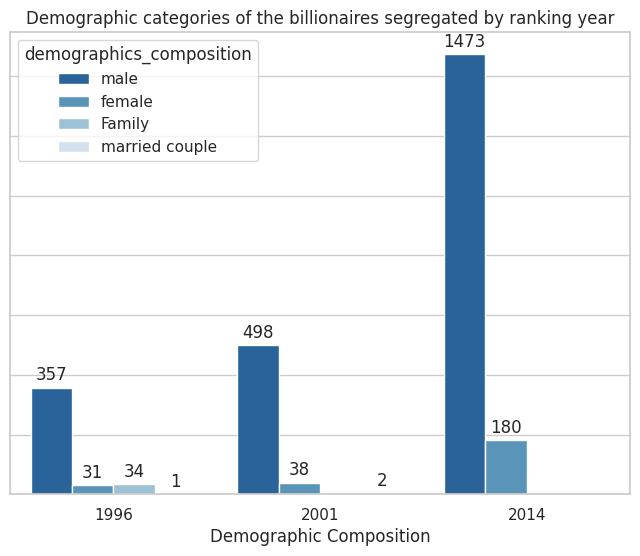

In [ ]:
fig, ax = plt.subplots(figsize=(8, 6))
com_plot = sns.barplot(x="year", y="name",
            hue='demographics_composition', data=dff2,
            palette='Blues_r')

for p in com_plot.patches:
    com_plot.annotate(format(p.get_height(), '.0f'),
                   (p.get_x() + p.get_width() / 2., p.get_height()),
                   ha='center', va='center',
                   xytext=(0, 9),
                   textcoords='offset points')
com_plot.set(yticklabels=[])
com_plot.set(title='Demographic categories of the billionaires segregated by ranking year')
com_plot.set(xlabel="Demographic Composition")
com_plot.set(ylabel=None)

fname7 = "demo.png"
plt.savefig(fname7, bbox_inches='tight', dpi=100)

In [ ]:
df_inh = df1.groupby(['How.wealth.was.gained', 'year']).count().reset_index()

dff3 = df_inh.sort_values('name',ascending = False).groupby('year').head(13000)

dff3

,How.wealth.was.gained,year,name,rank,company.founded,company.name,company.relationship,company.sector,company.type,demographics.age,demographics.gender,location.citizenship,location.country code,location.gdp,location.region,wealth.type,wealth.worth in billions,wealth.how.category,wealth.how.from emerging,wealth.how.industry,wealth.how.inherited,wealth.how.was founder,wealth.how.was political,demographics_composition
5,not inherited,2014,1151,1151,1151,1143,1149,1151,1151,1151,1151,1151,1151,1151,1151,1151,1151,1151,1151,1151,1151,1151,1151,1151
2,Inherited,2014,502,502,502,502,502,502,502,502,502,502,502,502,502,502,502,502,502,502,502,502,502,502
4,not inherited,2001,315,315,315,307,312,314,315,315,315,315,315,315,315,315,315,315,315,315,315,315,315,315
1,Inherited,2001,223,223,223,221,222,222,223,223,223,223,223,223,223,223,223,223,223,223,223,223,223,223
3,not inherited,1996,222,222,222,202,189,203,222,222,197,222,222,222,222,222,222,222,222,222,222,222,222,222
0,Inherited,1996,201,201,201,201,194,199,201,201,192,201,201,201,201,201,201,201,201,201,201,201,201,201


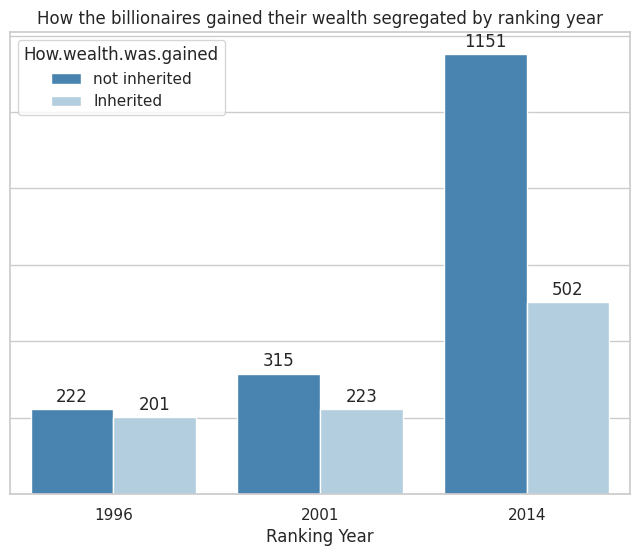

In [ ]:
fig, ax = plt.subplots(figsize=(8, 6))
com_plot = sns.barplot(x ="year", y="name",
            hue='How.wealth.was.gained', data=dff3,
            palette='Blues_r')

for p in com_plot.patches:
    com_plot.annotate(format(p.get_height(), '.0f'),
                   (p.get_x() + p.get_width() / 2., p.get_height()),
                   ha='center', va='center',
                   xytext=(0, 9),
                   textcoords='offset points')
com_plot.set(yticklabels=[])
com_plot.set(title='How the billionaires gained their wealth segregated by ranking year')
com_plot.set(xlabel="Ranking Year")
com_plot.set(ylabel=None)

fname8 = "gained.png"
plt.savefig(fname8, bbox_inches='tight', dpi=100)

In [ ]:
df_inh2 = df1.groupby(["demographics_composition",'How.wealth.was.gained', 'year']).count().reset_index()

dff4 = df_inh2.sort_values('name',ascending = False).groupby('year').head(13000)

dff4

,demographics_composition,How.wealth.was.gained,year,name,rank,company.founded,company.name,company.relationship,company.sector,company.type,demographics.age,demographics.gender,location.citizenship,location.country code,location.gdp,location.region,wealth.type,wealth.worth in billions,wealth.how.category,wealth.how.from emerging,wealth.how.industry,wealth.how.inherited,wealth.how.was founder,wealth.how.was political
13,male,not inherited,2014,1113,1113,1113,1105,1111,1113,1113,1113,1113,1113,1113,1113,1113,1113,1113,1113,1113,1113,1113,1113,1113
10,male,Inherited,2014,360,360,360,360,360,360,360,360,360,360,360,360,360,360,360,360,360,360,360,360,360
12,male,not inherited,2001,309,309,309,302,307,309,309,309,309,309,309,309,309,309,309,309,309,309,309,309,309
11,male,not inherited,1996,191,191,191,182,182,184,191,191,191,191,191,191,191,191,191,191,191,191,191,191,191
9,male,Inherited,2001,189,189,189,187,188,188,189,189,189,189,189,189,189,189,189,189,189,189,189,189,189
8,male,Inherited,1996,166,166,166,166,166,164,166,166,166,166,166,166,166,166,166,166,166,166,166,166,166
4,female,Inherited,2014,142,142,142,142,142,142,142,142,142,142,142,142,142,142,142,142,142,142,142,142,142
7,female,not inherited,2014,38,38,38,38,38,38,38,38,38,38,38,38,38,38,38,38,38,38,38,38,38
3,female,Inherited,2001,34,34,34,34,34,34,34,34,34,34,34,34,34,34,34,34,34,34,34,34,34
2,female,Inherited,1996,26,26,26,26,26,26,26,26,26,26,26,26,26,26,26,26,26,26,26,26,26


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:712: UserWarning: Using the barplot function without specifying `order` is likely to produce an incorrect plot.
  warnings.warn(warning)


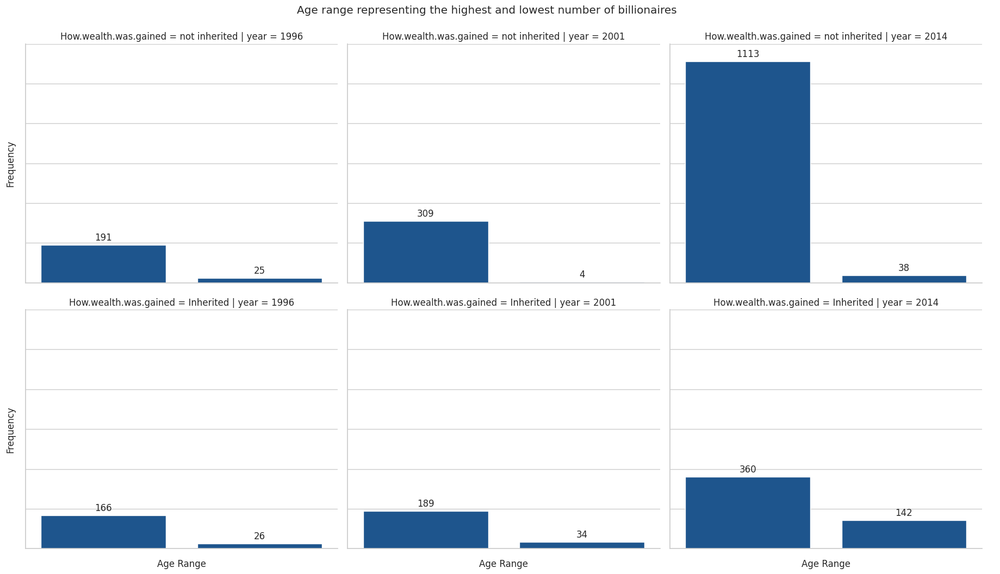

In [ ]:
gin1 = sns.FacetGrid(dff4, col="year", row = 'How.wealth.was.gained', height=5.2, aspect=1.2)
gin1= gin1.map(sns.barplot, "demographics_composition", 'name', errorbar=None)
#Age_group = Age_group.map(plt.hist, 'demographics.age', bins=[0, 17, 18, 24, 25,49,50,100])
gin1.add_legend()
gin1.set_xticklabels(rotation = 90)
gin1.set_yticklabels(labels= None)
gin1.set_xlabels(label="Age Range")
gin1.set_ylabels(label="Frequency")
gin1.fig.suptitle('Age range representing the highest and lowest number of billionaires',
               y=1.03)
#gin1.add_legend(legend_data=dff4['How.wealth.was.gained'], title=None, label_order=None, adjust_subtitles=False)
for ax in gin1.axes.ravel():
  for p in ax.patches:
    ax.annotate(format(p.get_height(), '.0f'), (p.get_x() + p.get_width() / 2., p.get_height()), ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points')
plt.show()

In [ ]:
df_inherited = df1.loc[df1['How.wealth.was.gained'] =='Inherited']

df_inh5 = df_inherited.groupby(['How.wealth.was.gained', 'wealth.how.inherited', 'year']).count().reset_index()

dff5 = df_inh5.sort_values('name',ascending = False).groupby('year').head(13000)

dff5

,How.wealth.was.gained,wealth.how.inherited,year,name,rank,company.founded,company.name,company.relationship,company.sector,company.type,demographics.age,demographics.gender,location.citizenship,location.country code,location.gdp,location.region,wealth.type,wealth.worth in billions,wealth.how.category,wealth.how.from emerging,wealth.how.industry,wealth.how.was founder,wealth.how.was political,demographics_composition
11,Inherited,father,2014,316,316,316,316,316,316,316,316,316,316,316,316,316,316,316,316,316,316,316,316,316
10,Inherited,father,2001,134,134,134,132,133,133,134,134,134,134,134,134,134,134,134,134,134,134,134,134,134
9,Inherited,father,1996,108,108,108,108,106,107,108,108,106,108,108,108,108,108,108,108,108,108,108,108,108
2,Inherited,3rd generation,2014,100,100,100,100,100,100,100,100,100,100,100,100,100,100,100,100,100,100,100,100,100
0,Inherited,3rd generation,1996,58,58,58,58,55,57,58,58,54,58,58,58,58,58,58,58,58,58,58,58,58
1,Inherited,3rd generation,2001,52,52,52,52,52,52,52,52,52,52,52,52,52,52,52,52,52,52,52,52,52
14,Inherited,spouse/widow,2014,38,38,38,38,38,38,38,38,38,38,38,38,38,38,38,38,38,38,38,38,38
5,Inherited,4th generation,2014,33,33,33,33,33,33,33,33,33,33,33,33,33,33,33,33,33,33,33,33,33
3,Inherited,4th generation,1996,18,18,18,18,17,18,18,18,17,18,18,18,18,18,18,18,18,18,18,18,18
4,Inherited,4th generation,2001,17,17,17,17,17,17,17,17,17,17,17,17,17,17,17,17,17,17,17,17,17


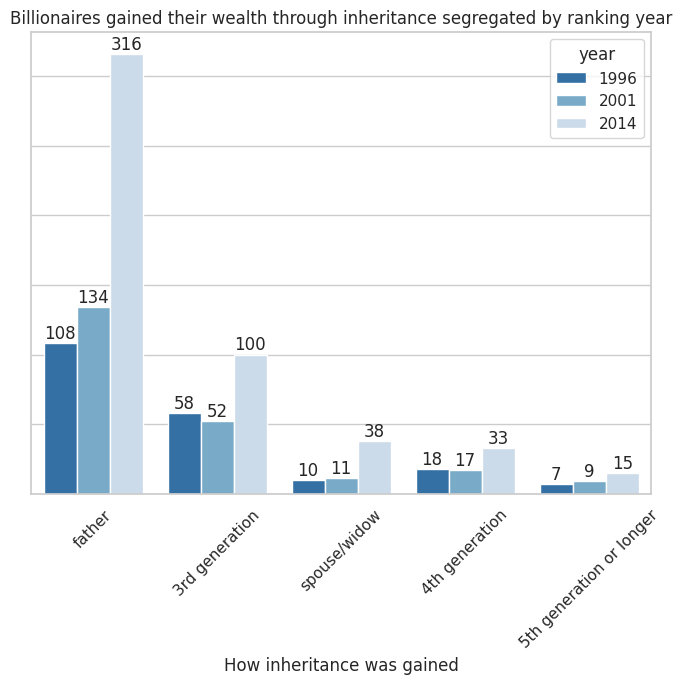

In [ ]:
fig, ax = plt.subplots(figsize=(8, 6))
cin = sns.barplot(x ="wealth.how.inherited", y="name",
            hue='year', data=dff5,
            palette='Blues_r')

for p in cin.patches:
    cin.annotate(format(p.get_height(), '.0f'),
                   (p.get_x() + p.get_width() / 2., p.get_height()),
                   ha='center', va='center',
                   xytext=(0, 7),
                   textcoords='offset points')
cin.set(yticklabels=[])
cin.set(title='Billionaires gained their wealth through inheritance segregated by ranking year')
cin.set(xlabel="How inheritance was gained")
cin.set(ylabel=None)
plt.xticks(rotation=45)
fname9 = "int.png"
plt.savefig(fname9, bbox_inches='tight', dpi=100)

In [ ]:


df_inh6 = df_inherited.groupby(['How.wealth.was.gained', 'wealth.how.category', 'year']).count().reset_index()

dff6 = df_inh6.sort_values('name',ascending = False).groupby('year').head(13000)

dff6

,How.wealth.was.gained,wealth.how.category,year,name,rank,company.founded,company.name,company.relationship,company.sector,company.type,demographics.age,demographics.gender,location.citizenship,location.country code,location.gdp,location.region,wealth.type,wealth.worth in billions,wealth.how.from emerging,wealth.how.industry,wealth.how.inherited,wealth.how.was founder,wealth.how.was political,demographics_composition
17,Inherited,Traded Sectors,2014,153,153,153,153,153,153,153,153,153,153,153,153,153,153,153,153,153,153,153,153,153
2,Inherited,Financial,2014,137,137,137,137,137,137,137,137,137,137,137,137,137,137,137,137,137,137,137,137,137
8,Inherited,Non-Traded Sectors,2014,111,111,111,111,111,111,111,111,111,111,111,111,111,111,111,111,111,111,111,111,111
15,Inherited,Traded Sectors,1996,63,63,63,63,58,62,63,63,57,63,63,63,63,63,63,63,63,63,63,63,63
7,Inherited,Non-Traded Sectors,2001,62,62,62,61,61,61,62,62,62,62,62,62,62,62,62,62,62,62,62,62,62
1,Inherited,Financial,2001,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59
16,Inherited,Traded Sectors,2001,56,56,56,56,56,56,56,56,56,56,56,56,56,56,56,56,56,56,56,56,56
0,Inherited,Financial,1996,52,52,52,52,52,51,52,52,52,52,52,52,52,52,52,52,52,52,52,52,52
6,Inherited,Non-Traded Sectors,1996,51,51,51,51,50,51,51,51,50,51,51,51,51,51,51,51,51,51,51,51,51
14,Inherited,Resource Related,2014,48,48,48,48,48,48,48,48,48,48,48,48,48,48,48,48,48,48,48,48,48


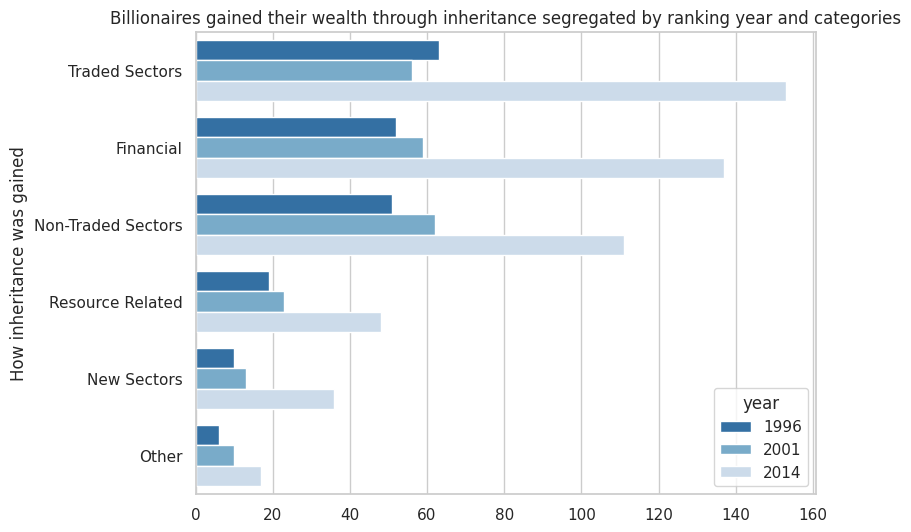

In [ ]:
fig, ax = plt.subplots(figsize=(8, 6))
wcin = sns.barplot(x ="name", y='wealth.how.category',
            hue='year', data=dff6,
            palette='Blues_r')


wcin.set(title='Billionaires gained their wealth through inheritance segregated by ranking year and categories')
wcin.set(ylabel="How inheritance was gained")
wcin.set(xlabel=None)

fname10 = "intcat.png"
plt.savefig(fname10, bbox_inches='tight', dpi=100)

In [ ]:
df_inh7 = df_inherited.groupby(['How.wealth.was.gained', 'location.region', 'year']).count().reset_index()

dff7 = df_inh7.sort_values('name',ascending = False).groupby('year').head(13000)

dff7

,How.wealth.was.gained,location.region,year,name,rank,company.founded,company.name,company.relationship,company.sector,company.type,demographics.age,demographics.gender,location.citizenship,location.country code,location.gdp,wealth.type,wealth.worth in billions,wealth.how.category,wealth.how.from emerging,wealth.how.industry,wealth.how.inherited,wealth.how.was founder,wealth.how.was political,demographics_composition
5,Inherited,Europe,2014,169,169,169,169,169,169,169,169,169,169,169,169,169,169,169,169,169,169,169,169,169
14,Inherited,North America,2014,160,160,160,160,160,160,160,160,160,160,160,160,160,160,160,160,160,160,160,160,160
13,Inherited,North America,2001,104,104,104,103,104,104,104,104,104,104,104,104,104,104,104,104,104,104,104,104,104
12,Inherited,North America,1996,74,74,74,74,74,74,74,74,74,74,74,74,74,74,74,74,74,74,74,74,74
4,Inherited,Europe,2001,61,61,61,60,60,60,61,61,61,61,61,61,61,61,61,61,61,61,61,61,61
2,Inherited,East Asia,2014,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60,60
3,Inherited,Europe,1996,59,59,59,59,52,58,59,59,51,59,59,59,59,59,59,59,59,59,59,59,59
8,Inherited,Latin America,2014,57,57,57,57,57,57,57,57,57,57,57,57,57,57,57,57,57,57,57,57,57
0,Inherited,East Asia,1996,37,37,37,37,37,36,37,37,37,37,37,37,37,37,37,37,37,37,37,37,37
11,Inherited,Middle East/North Africa,2014,34,34,34,34,34,34,34,34,34,34,34,34,34,34,34,34,34,34,34,34,34


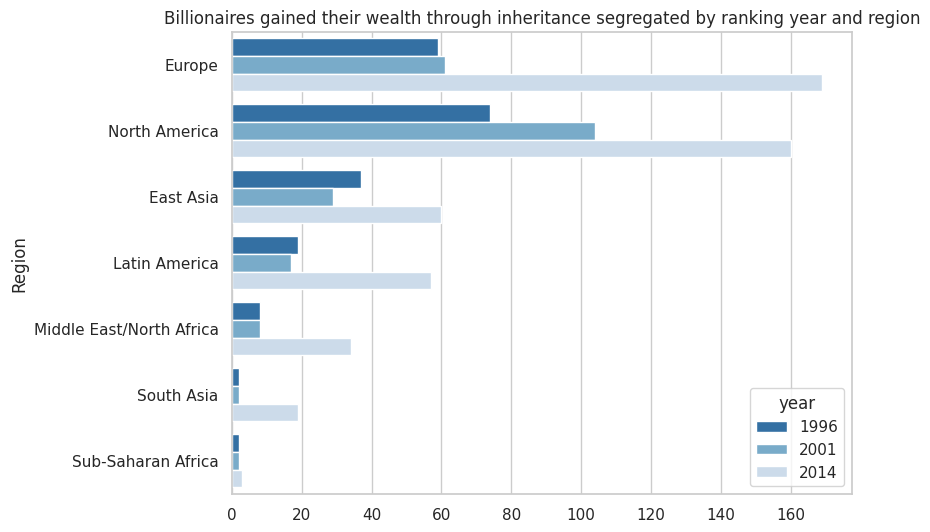

In [ ]:
fig, ax = plt.subplots(figsize=(8, 6))
lrcin = sns.barplot(x ="name", y='location.region',
            hue='year', data=dff7,
            palette='Blues_r')


lrcin.set(title='Billionaires gained their wealth through inheritance segregated by ranking year and region')
lrcin.set(ylabel="Region")
lrcin.set(xlabel=None)
fname11 = "intr.png"
plt.savefig(fname11, bbox_inches='tight', dpi=100)

In [ ]:
df_t3 = df1.groupby(['year','wealth.worth in billions','rank']).count().reset_index()

dff8 = df_t3.sort_values('wealth.worth in billions',ascending = False).groupby('year').head(3)


dff8

,year,wealth.worth in billions,rank,name,company.founded,company.name,company.relationship,company.sector,company.type,demographics.age,demographics.gender,location.citizenship,location.country code,location.gdp,location.region,wealth.type,wealth.how.category,wealth.how.from emerging,wealth.how.industry,wealth.how.inherited,wealth.how.was founder,wealth.how.was political,demographics_composition,How.wealth.was.gained
692,2014,76.0,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1
691,2014,72.0,2,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1
690,2014,64.0,3,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1
510,2001,58.7,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1
509,2001,32.3,2,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1
508,2001,30.4,3,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1
422,1996,18.5,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1
421,1996,15.0,2,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1
420,1996,13.1,3,1,1,1,0,1,1,1,0,1,1,1,1,1,1,1,1,1,1,1,1,1


In [ ]:
df_pivot3 = pd.pivot_table(dff8,
                          values='wealth.worth in billions',
                          index= 'rank',
                          columns= 'year')
df_pivot3

year,1996,2001,2014
rank,,,
1,18.5,58.7,76.0
2,15.0,32.3,72.0
3,13.1,30.4,64.0


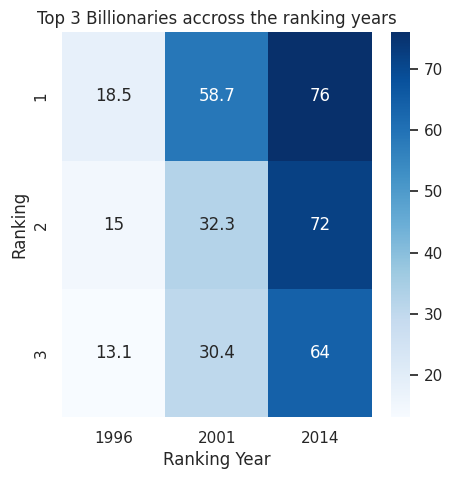

In [ ]:
plt.figure(figsize = (5,5))
plt.title('Top 3 Billionaries accross the ranking years')

sns.heatmap(df_pivot3, annot=True, cmap='Blues', fmt= '.4g',)
plt.xlabel('Ranking Year')
plt.ylabel('Ranking')
fname13 = "BR.png"
plt.savefig(fname13, bbox_inches='tight', dpi=100)
plt.show()

In [ ]:
df_FemaleB = df1.loc[df1['demographics.gender'] =='female']
df_maleB = df1.loc[df1['demographics.gender'] =='male']
df_MF = pd.concat([df_maleB, df_FemaleB])
df_MF

,name,rank,year,company.founded,company.name,company.relationship,company.sector,company.type,demographics.age,demographics.gender,location.citizenship,location.country code,location.gdp,location.region,wealth.type,wealth.worth in billions,wealth.how.category,wealth.how.from emerging,wealth.how.industry,wealth.how.inherited,wealth.how.was founder,wealth.how.was political,demographics_composition,How.wealth.was.gained
0,Bill Gates,1,1996,1975,Microsoft,founder,Software,new,40,male,United States,USA,8.100000e+12,North America,founder non-finance,18.5,New Sectors,True,Technology-Computer,not inherited,True,True,male,not inherited
1,Bill Gates,1,2001,1975,Microsoft,founder,Software,new,45,male,United States,USA,1.060000e+13,North America,founder non-finance,58.7,New Sectors,True,Technology-Computer,not inherited,True,True,male,not inherited
2,Bill Gates,1,2014,1975,Microsoft,founder,Software,new,58,male,United States,USA,1.755068e+13,North America,founder non-finance,76.0,New Sectors,True,Technology-Computer,not inherited,True,True,male,not inherited
3,Warren Buffett,2,1996,1962,Berkshire Hathaway,founder,Finance,new,65,male,United States,USA,8.100000e+12,North America,founder non-finance,15.0,Traded Sectors,True,Consumer,not inherited,True,True,male,not inherited
4,Warren Buffett,2,2001,1962,Berkshire Hathaway,founder,Finance,new,70,male,United States,USA,1.060000e+13,North America,founder non-finance,32.3,Traded Sectors,True,Consumer,not inherited,True,True,male,not inherited
5,Carlos Slim Helu,2,2014,1990,Telmex,founder,Communications,privatized,74,male,Mexico,MEX,1.315351e+12,Latin America,privatized and resources,72.0,Non-Traded Sectors,True,Media,not inherited,True,True,male,not inherited
7,Paul Allen,3,2001,1975,Microsoft,founder,technology,new,48,male,United States,USA,1.060000e+13,North America,founder non-finance,30.4,New Sectors,True,Technology-Computer,not inherited,True,True,male,not inherited
8,Amancio Ortega,3,2014,1975,Zara,founder,Fashion,new,77,male,Spain,ESP,1.371821e+12,Europe,founder non-finance,64.0,Non-Traded Sectors,True,Retail,not inherited,True,True,male,not inherited
9,Lee Shau Kee,4,1996,1976,Henderson Land Development,founder/chairman,real estate,new,68,male,Hong Kong,HKG,1.600000e+11,East Asia,self-made finance,12.7,Financial,True,Real Estate,not inherited,True,True,male,not inherited
10,Larry Ellison,4,2001,1977,Oracle,founder,software,new,56,male,United States,USA,1.060000e+13,North America,founder non-finance,26.0,New Sectors,True,Technology-Computer,not inherited,True,True,male,not inherited


In [ ]:
df_t4 = df_FemaleB.groupby(['year','wealth.worth in billions','demographics.gender']).count().reset_index()

dff9 = df_t4.sort_values('wealth.worth in billions',ascending = False).groupby('year').head(1)

df_t5 = df_maleB.groupby(['year','wealth.worth in billions','demographics.gender']).count().reset_index()

dff10 = df_t5.sort_values('wealth.worth in billions',ascending = False).groupby('year').head(1)

df_MF1 = pd.concat([dff10, dff9])

df_MF1

,year,wealth.worth in billions,demographics.gender,name,rank,company.founded,company.name,company.relationship,company.sector,company.type,demographics.age,location.citizenship,location.country code,location.gdp,location.region,wealth.type,wealth.how.category,wealth.how.from emerging,wealth.how.industry,wealth.how.inherited,wealth.how.was founder,wealth.how.was political,demographics_composition,How.wealth.was.gained
300,2014,76.0,male,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1
141,2001,58.7,male,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1
58,1996,18.5,male,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1
98,2014,36.7,female,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1
36,2001,18.5,female,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2
18,1996,8.1,female,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1


In [ ]:
df_pivot4 = pd.pivot_table(df_MF1,
                          values='wealth.worth in billions',
                          index= 'demographics.gender',
                          columns= 'year')
df_pivot4

year,1996,2001,2014
demographics.gender,,,
female,8.1,18.5,36.7
male,18.5,58.7,76.0


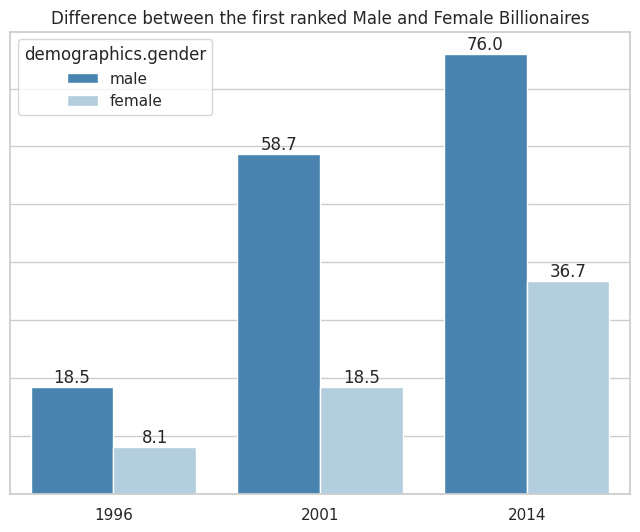

In [ ]:
fig, ax = plt.subplots(figsize=(8, 6))
fmc = sns.barplot(x ="year", y="wealth.worth in billions",
            hue="demographics.gender", data=df_MF1,
            palette='Blues_r')

for p in fmc.patches:
    fmc.annotate(format(p.get_height(), '.1f'),
                   (p.get_x() + p.get_width() / 2., p.get_height()),
                   ha='center', va='center',
                   xytext=(0, 7),
                   textcoords='offset points')
fmc.set(yticklabels=[])
fmc.set(title='Difference between the first ranked Male and Female Billionaires')
fmc.set(xlabel=None)
fmc.set(ylabel=None)

fname14 = "MFG.png"
plt.savefig(fname14, bbox_inches='tight', dpi=100)

Cumulative etworth

In [ ]:
df_FB2 = df_FemaleB.groupby(['year', 'wealth.how.industry']).sum().reset_index()
dffiltered10 = df_FB2.sort_values('wealth.worth in billions',ascending = False).groupby('year').head(13000)  # Grouping and sorting the table

dffiltered10

<ipython-input-123-e4d6a8671ce3>:1: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  df_FB2 = df_FemaleB.groupby(['year', 'wealth.how.industry']).sum().reset_index()


,year,wealth.how.industry,rank,company.founded,demographics.age,location.gdp,wealth.worth in billions,wealth.how.from emerging,wealth.how.was founder,wealth.how.was political
18,2014,Consumer,32912,86658,2505,3.394531e+14,207.3,45,45,45
27,2014,Retail,16136,38928,995,2.450926e+14,114.7,20,20,20
10,2001,Consumer,3319,28836,614,1.114550e+14,88.1,15,15,15
26,2014,Real Estate,15999,41365,1124,2.104899e+14,63.3,21,21,21
23,2014,Money Management,13199,28991,958,1.006968e+14,50.4,15,15,15
22,2014,Mining and metals,7698,17084,631,1.029395e+13,49.9,9,9,9
21,2014,Media,8087,21056,677,7.704382e+13,45.6,11,11,11
24,2014,Non-consumer industrial,9648,25096,662,1.010481e+14,42.5,13,13,13
19,2014,Diversified financial,8024,21325,768,7.121879e+13,37.9,11,11,11
1,1996,Consumer,2544,22894,493,6.975000e+13,32.6,12,12,12


In [ ]:
list_industries = list(set(dffiltered10['wealth.how.industry'])) # List of industries
list_industries

['Non-consumer industrial',
 'Media',
 'Consumer',
 'Construction',
 'Other',
 'Technology-Medical',
 'Mining and metals',
 'Retail',
 'Technology-Computer',
 'Real Estate',
 'Energy',
 'Money Management',
 'Diversified financial']

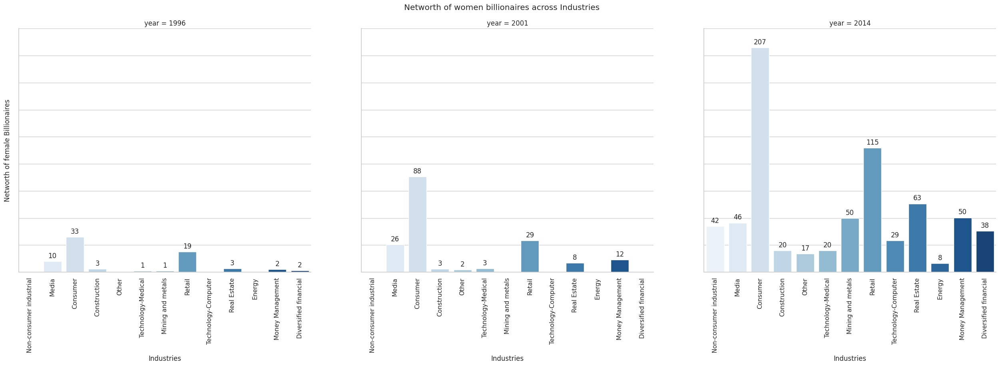

In [ ]:
FB_Ind = sns.FacetGrid(dffiltered10, col="year", height=7.2, aspect=1.2, despine = True)
FB_Ind = FB_Ind.map(sns.barplot, 'wealth.how.industry', 'wealth.worth in billions', palette="Blues", errorbar=None, order = list_industries)


FB_Ind.set_xticklabels(rotation = 90)
FB_Ind.set_yticklabels(labels= None)
FB_Ind.set_xlabels(label="Industries")
FB_Ind.set_ylabels(label="Networth of female Billionaires")
FB_Ind.fig.suptitle('Networth of women billionaires across Industries ',
               y=1.03)
for ax in FB_Ind.axes.ravel():
  for p in ax.patches:
    ax.annotate(format(p.get_height(), '.0f'), (p.get_x() + p.get_width() / 2., p.get_height()), ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points')

fname20 = "FIdb.png"
plt.savefig(fname20, bbox_inches='tight', dpi=100)
plt.show() # Plotting the Chart

billioaries networth by countries

In [ ]:
df_Ryears20 = df1.groupby(['year','location.citizenship']).sum().reset_index()
dffiltered21 = df_Ryears20.sort_values('wealth.worth in billions',ascending = False).groupby('year').head(10) # Filterig for the top 10 countries
dffiltered21

<ipython-input-126-4bd9902a7ffe>:1: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  df_Ryears20 = df1.groupby(['year','location.citizenship']).sum().reset_index()


,year,location.citizenship,rank,company.founded,demographics.age,location.gdp,wealth.worth in billions,wealth.how.from emerging,wealth.how.was founder,wealth.how.was political
152,2014,United States,367851,977568,31811,8.757789e+15,2322.4,499,499,499
84,2001,United States,71715,523655,13860,2.851400e+15,907.6,269,269,269
134,2014,Russia,97160,216555,5772,2.285759e+14,422.5,111,111,111
104,2014,Germany,51401,163852,5350,3.305729e+14,401.4,85,85,85
95,2014,China,150807,292792,7840,1.592304e+15,375.8,152,152,152
38,1996,United States,32158,261222,6158,1.093500e+15,312.1,135,135,135
102,2014,France,31828,83579,2906,1.228065e+14,235.3,43,43,43
107,2014,Hong Kong,32871,88655,2798,1.311567e+13,213.7,45,45,45
92,2014,Brazil,61749,127003,4015,1.596396e+14,192.2,65,65,65
108,2014,India,49289,109902,3422,1.141911e+14,191.9,56,56,56


In [ ]:
list_countries = list(set(dffiltered21['location.citizenship'])) # List of the countries from the filter table
list_countries

['Russia',
 'China',
 'India',
 'Italy',
 'Saudi Arabia',
 'Hong Kong',
 'Canada',
 'Brazil',
 'Switzerland',
 'Taiwan',
 'Germany',
 'Malaysia',
 'Mexico',
 'United States',
 'Sweden',
 'United Kingdom',
 'Indonesia',
 'France',
 'Japan']

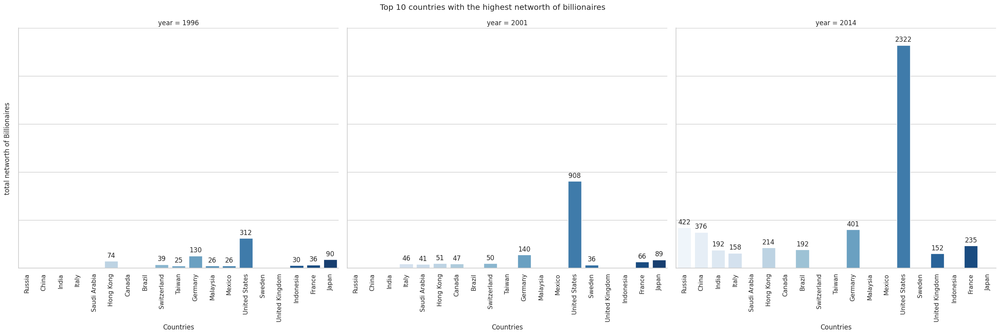

In [ ]:

T10Cs = sns.FacetGrid(dffiltered21, col="year", height=7.2, aspect=1.2, despine = True)
T10Cs = T10Cs.map(sns.barplot, 'location.citizenship', 'wealth.worth in billions', palette="Blues", errorbar=None, order = list_countries)


T10Cs.set_xticklabels(rotation = 90)
T10Cs.set_yticklabels(labels= None)
T10Cs.set_xlabels(label="Countries")
T10Cs.set_ylabels(label="total networth of Billionaires")
T10Cs.fig.suptitle('Top 10 countries with the highest networth of billionaires',
               y=1.03)
for ax in T10Cs.axes.ravel():
  for p in ax.patches:
    ax.annotate(format(p.get_height(), '.0f'), (p.get_x() + p.get_width() / 2., p.get_height()), ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points')

fname31 = "T1012.png"
plt.savefig(fname31, bbox_inches='tight', dpi=100)
plt.show() # plotting the charts

Most Sucessfull Sectors by networth

In [ ]:
df_sucsec2 = df1.groupby(['year', 'wealth.how.industry']).sum().reset_index()
dffiltered40 = df_sucsec2.sort_values('wealth.worth in billions',ascending = False).groupby('year').head(13000) # Grouping and sorting the tables

dffiltered40

<ipython-input-129-bf9eca135f68>:1: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  df_sucsec2 = df1.groupby(['year', 'wealth.how.industry']).sum().reset_index()


,year,wealth.how.industry,rank,company.founded,demographics.age,location.gdp,wealth.worth in billions,wealth.how.from emerging,wealth.how.was founder,wealth.how.was political
33,2014,Consumer,230309,564969,17867,1.906089e+15,1177.8,291,291,291
44,2014,Retail,134862,340996,10629,1.350873e+15,822.8,175,175,175
45,2014,Technology-Computer,101990,260287,7139,1.354063e+15,684.6,131,131,131
34,2014,Diversified financial,94989,256692,8293,7.832392e+14,614.4,132,132,132
43,2014,Real Estate,167705,358103,11925,1.350367e+15,575.0,191,191,191
37,2014,Media,77974,204142,6499,8.238577e+14,490.5,104,104,104
39,2014,Money Management,100164,238771,7790,7.660033e+14,381.3,122,122,122
17,2001,Consumer,21191,181857,4474,5.136486e+14,363.9,94,94,94
35,2014,Energy,69948,171623,5302,6.484181e+14,340.5,87,87,87
40,2014,Non-consumer industrial,69830,162996,4732,4.714474e+14,298.4,83,83,83


In [ ]:
df_pivot40 = pd.pivot_table(dffiltered40,
                          values='wealth.worth in billions',
                          index= 'wealth.how.industry',
                          columns= 'year') # Pivoting the grouped and sorted table
df_pivot40

year,1996,2001,2014
wealth.how.industry,,,
Construction,25.1,37.4,175.4
Consumer,218.3,363.9,1177.8
Diversified financial,66.7,24.2,614.4
Energy,29.6,63.2,340.5
Hedge funds,25.9,30.7,167.2
Media,105.5,258.1,490.5
Mining and metals,23.7,18.5,241.6
Money Management,124.6,204.8,381.3
Non-consumer industrial,30.6,19.9,298.4


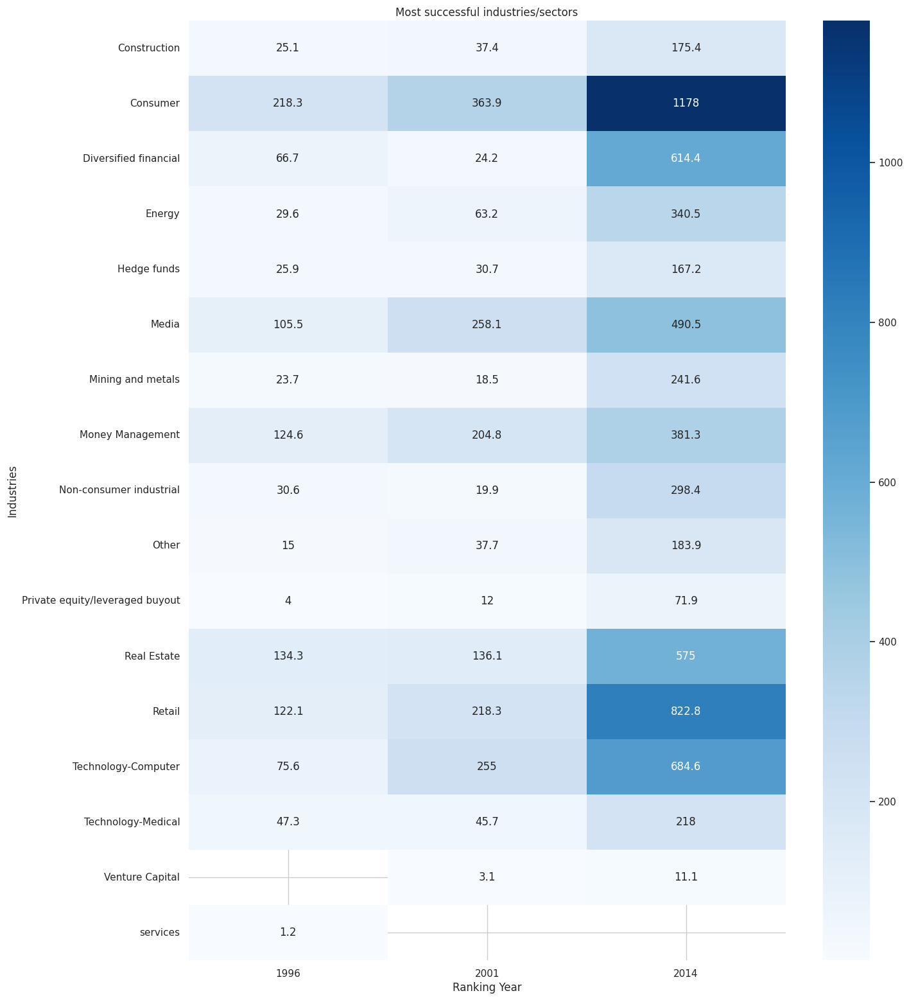

In [ ]:
plt.figure(figsize = (15,19))
plt.title('Most successful industries/sectors')

sns.heatmap(df_pivot40, annot=True, cmap='Blues', fmt= '.4g',)
plt.xlabel('Ranking Year')
plt.ylabel('Industries')

fname40 = "MSIB1.png"
plt.savefig(fname40, bbox_inches='tight', dpi=100)
plt.show() # Ploting the chart

Age by Networth

In [ ]:
df_ageB2 = df_FilteredAge.groupby(['year', 'age_group']).sum().reset_index()
dffiltered50 = df_ageB2.sort_values('wealth.worth in billions',ascending = False).groupby('year').head(13000)  #Grouping and sorting the table

dffiltered50

<ipython-input-132-53da0696c096>:1: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  df_ageB2 = df_FilteredAge.groupby(['year', 'age_group']).sum().reset_index()


,year,age_group,rank,company.founded,demographics.age,location.gdp,wealth.worth in billions,wealth.how.from emerging,wealth.how.was founder,wealth.how.was political
20,2014,"(50, 100]",1011381,2500796,86860,9.513089e+15,5222.8,1284,1284,1284
13,2001,"(50, 100]",81018,647655,22187,2.107680e+15,1122.5,336,336,336
18,2014,"(25, 49]",228525,506612,11530,1.832005e+15,886.8,259,259,259
6,1996,"(50, 100]",31499,321701,10887,7.556047e+14,468.2,168,168,168
11,2001,"(25, 49]",17925,135187,2877,4.408670e+14,290.5,69,69,69
19,2014,"(49, 50]",42136,88943,2300,3.050826e+14,158.3,46,46,46
4,1996,"(25, 49]",10484,87061,1853,2.247813e+14,109.2,45,45,45
12,2001,"(49, 50]",3845,21537,550,4.741700e+13,21.0,11,11,11
5,1996,"(49, 50]",1772,15495,400,1.830206e+13,16.8,8,8,8
2,1996,"(18, 24]",837,3855,45,1.620000e+13,2.0,2,2,2


In [ ]:
list_age_bracket = list(set(dffiltered50['age_group'])).sort()
list_age_bracket

/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:712: UserWarning: Using the barplot function without specifying `order` is likely to produce an incorrect plot.
  warnings.warn(warning)


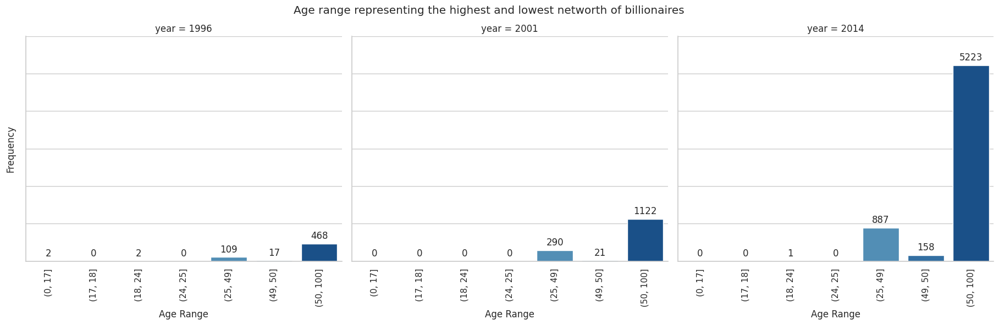

In [ ]:
Age_group = sns.FacetGrid(dffiltered50, col="year", height=5.2, aspect=1.2, despine = True)
Age_group = Age_group.map(sns.barplot, 'age_group', 'wealth.worth in billions', palette="Blues", errorbar=None)

Age_group.set_xticklabels(rotation = 90)
Age_group.set_yticklabels(labels= None)
Age_group.set_xlabels(label="Age Range")
Age_group.set_ylabels(label="Frequency")
Age_group.fig.suptitle('Age range representing the highest and lowest networth of billionaires',
               y=1.03)
for ax in Age_group.axes.ravel():
  for p in ax.patches:
    ax.annotate(format(p.get_height(), '.0f'), (p.get_x() + p.get_width() / 2., p.get_height()), ha = 'center',
                va = 'center', xytext = (0, 10), textcoords = 'offset points')
fname50 = "AGEB.png"
plt.savefig(fname50, bbox_inches='tight', dpi=100)
plt.show()

In [ ]:
df_region = df1.groupby(['How.wealth.was.gained', 'location.region', 'year']).count().reset_index()

dff100 = df_region.sort_values('name',ascending = False).groupby('year').head(13000)

dff100

,How.wealth.was.gained,location.region,year,name,rank,company.founded,company.name,company.relationship,company.sector,company.type,demographics.age,demographics.gender,location.citizenship,location.country code,location.gdp,wealth.type,wealth.worth in billions,wealth.how.category,wealth.how.from emerging,wealth.how.industry,wealth.how.inherited,wealth.how.was founder,wealth.how.was political,demographics_composition
35,not inherited,North America,2014,402,402,402,397,402,402,402,402,402,402,402,402,402,402,402,402,402,402,402,402,402
26,not inherited,Europe,2014,301,301,301,298,301,301,301,301,301,301,301,301,301,301,301,301,301,301,301,301,301
23,not inherited,East Asia,2014,291,291,291,291,289,291,291,291,291,291,291,291,291,291,291,291,291,291,291,291,291
34,not inherited,North America,2001,186,186,186,181,185,185,186,186,186,186,186,186,186,186,186,186,186,186,186,186,186
5,Inherited,Europe,2014,169,169,169,169,169,169,169,169,169,169,169,169,169,169,169,169,169,169,169,169,169
14,Inherited,North America,2014,160,160,160,160,160,160,160,160,160,160,160,160,160,160,160,160,160,160,160,160,160
13,Inherited,North America,2001,104,104,104,103,104,104,104,104,104,104,104,104,104,104,104,104,104,104,104,104,104
21,not inherited,East Asia,1996,79,79,79,67,66,68,79,79,72,79,79,79,79,79,79,79,79,79,79,79,79
12,Inherited,North America,1996,74,74,74,74,74,74,74,74,74,74,74,74,74,74,74,74,74,74,74,74,74
33,not inherited,North America,1996,67,67,67,67,67,67,67,67,67,67,67,67,67,67,67,67,67,67,67,67,67


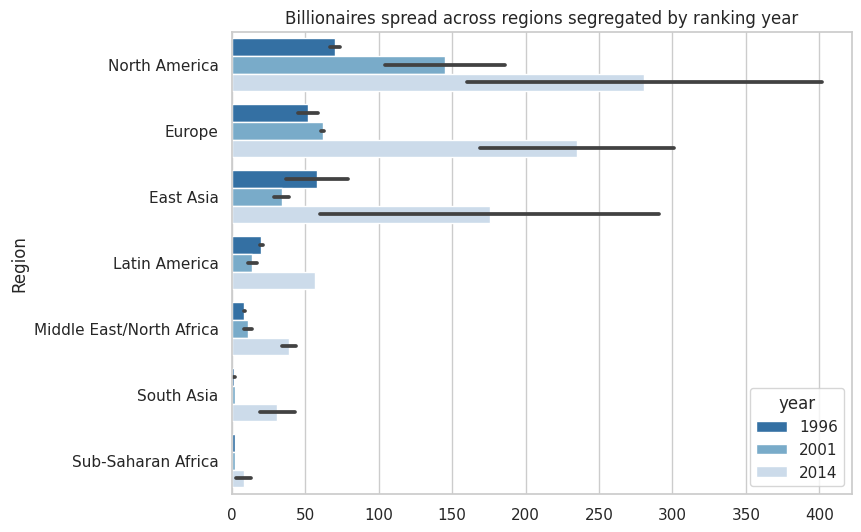

In [ ]:
fig, ax = plt.subplots(figsize=(8, 6))
lrcin = sns.barplot(x ="name", y='location.region',
            hue='year', data=dff100,
            palette='Blues_r')


lrcin.set(title='Billionaires spread across regions segregated by ranking year')
lrcin.set(ylabel="Region")
lrcin.set(xlabel=None)
fname1100 = "regiong.png"
plt.savefig(fname1100, bbox_inches='tight', dpi=100)